# Setting up the notebook

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import json
import requests
import flickrapi
import time
import folium
from folium import plugins
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import plotly.express as px
import plotly.io as pio
import geopy
from geopy.geocoders import Nominatim
from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook
from bokeh.models import ColumnDataSource, HoverTool
from bokeh.layouts import column
from bokeh.models import NumeralTickFormatter
from sklearn import cluster
from sklearn import preprocessing
import xml.etree.ElementTree as ET
from collections import defaultdict

In [2]:
pip install geojsonio


  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 151.8/151.8 KB 23.2 MB/s eta 0:00:00
  Created wheel for geojsonio: filename=geojsonio-0.0.3-py3-none-any.whl size=5039 sha256=6057d931b425f7b3a6619eb8ccf0eefceebb59d5fde4925d13a5094a5fd41154
  Stored in directory: /root/.cache/pip/wheels/e7/b2/e2/921bfd3faf1079a0532f2ff0bef397f4e2b40bce35d3e52153
Successfully built geojsonio
You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install openpyxl 

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.0/250.0 KB 32.1 MB/s eta 0:00:00
You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


# Motivation

During periods of stress, such as during exam seasons, individuals may look forward to vacations in foreign countries to relax and destress. Among the numerous locations available, Spain is a particularly attractive destination, renowned for its crystal-clear waters, sunny and warm climate, and holiday-like atmosphere throughout the year. However, the global tourism industry, including Spain, was adversely affected by the outbreak of COVID-19, which hit hardest in this beautiful country, despite its position as one of the world's largest tourism destinations prior to 2020.

By examining the correlation between COVID-19 cases and hospitalizations in Spain and its regions, we can delve into and analyze the possible tourist attractions that facilitated a smoother transition post-pandemic. Quantifying the relationship between the pandemic and tourism is crucial in understanding which regions have performed best in returning to pre-pandemic levels and in formulating contingency plans for future pandemics.

This study aims to address three primary questions concerning Spanish regions and their response to the pandemic:
1. How was Spain affected by COVID based on the amount of cases?
2. How has tourism been affected in Spain pre and post-COVID?
3. What measures did the quickest responding regions take to return to pre-pandemic tourism levels?

Quantifying this relationship is fundamental in predicting the pandemic's impact on the tourism sector and improving the response of tourist municipalities and agencies to such crises.

# Basic stats

In this section, we'll look into the datasets in order to better understand them. This includes an initial exploration to first clean and preprocess the data in regards of the COVID cases, and subsequently we will explore the different Spanish regions in terms of tourism.

- The COVID dataset was found at: https://cnecovid.isciii.es/covid19/#documentación-y-datos
- The tourism dataset was found at: https://www.ine.es/dynt3/inebase/es/index.htm?padre=8578&capsel=8580

## COVID dataset

### Data cleaning and preprocessing

In [4]:
#Import data
covid_data = pd.read_csv("CovidData.csv") 
covid_data.head()

,provincia_iso,sexo,grupo_edad,fecha,num_casos,num_hosp,num_uci,num_def
0,A,H,0-9,2020-01-01,0,0,0,0
1,A,H,10-19,2020-01-01,0,0,0,0
2,A,H,20-29,2020-01-01,0,0,0,0
3,A,H,30-39,2020-01-01,0,0,0,0
4,A,H,40-49,2020-01-01,0,0,0,0


The columns are the following: 
- **provincia_iso**: ISO code of the province of residence. NC (not stated) 
- **sexo**: sex of the cases - H (man), M (woman), NC (not stated)
- **group_edad**: Age group to which the case belongs: 0-9, 10-19, 20-29, 30-39, 40-49, 50-59, 60-69, 70-79, ≥80 years. NC: not stated. After March 28 only groups over 60 years old. 
- **fecha**: cases: In cases prior to May 11, the date of diagnosis is used, in its absence the date of declaration to the community and, in its absence, the key date (date used for statistics by the CCAAs). In cases after May 10, in the absence of a date of diagnosis, the key date1 is used. Hospitalizations, ICU admissions, deaths: hospitalized cases are represented by date of hospitalization (failing that, the date of diagnosis, and failing that, the key date, ICU cases by date of admission to the ICU (failing that, the date of diagnosis, and failing that, the key date) and deaths by date of death (failing that, the date of diagnosis, and failing that, the key date).
- **num_casos**: Number of reported confirmed cases with a positive diagnostic test for active infection (PDIA) as established in the COVID-19 Early Detection, Surveillance, and Control Strategy, plus cases reported before May 11 that required hospitalization, admission to ICU or died with a clinical diagnosis of COVID-19, according to the current case definitions at any given time.
- **num_hosp**: Number of hospitalized cases
- **num_uci**: Number of cases admitted to the ICU
- **num_def**: Number of deaths 

First of all, we remove the column that we are not going to use. In this case, that is the num_uci column as it refers to hospitalization cases that ended in the ICU. Considering that the amount is within the num_hosp value, it is redundant.

In [5]:
#Remove columns we are not going to use
#Remove the ICU columns as the numbers are considered within the hospitalization numbers
covid_data.drop("num_uci", axis=1, inplace=True)  
covid_data.columns

Index(['provincia_iso', 'sexo', 'grupo_edad', 'fecha', 'num_casos', 'num_hosp',
       'num_def'],
      dtype='object')

As the dataset is from a Spanish source, the abbreviations also refer to spanish words. In the following section we transform the spanish abbreviations to English terms to have a better and clearer understanding of the dataset. Furthermore, each abbreviation is discussed in order to understand what it refers to.

In [6]:
#Change column names to English words
covid_data = covid_data.rename(columns={'provincia_iso': 'Province', 'sexo': 'Sex', 'grupo_edad': 'Age_Groups', 'fecha': 'Date', 'num_casos': 'Cases', 'num_hosp':'Hospitalizations', 'num_def':'Deaths'})
covid_data.columns

Index(['Province', 'Sex', 'Age_Groups', 'Date', 'Cases', 'Hospitalizations',
       'Deaths'],
      dtype='object')

In [7]:
#Change abbreviations within the gender column to refer to English words
covid_data.loc[ covid_data['Sex'] == 'H', 'Sex'] = 'Male' #For Male
covid_data.loc[ covid_data['Sex'] == 'M', 'Sex'] = 'Female' #For Female
covid_data.loc[ covid_data['Sex'] == 'NC', 'Sex'] = 'NotStated' 
#Change abbreviation for NC in the Age_Groups column
covid_data.loc[ covid_data['Age_Groups'] == 'NC', 'Age_Groups'] = 'NotStated' 

covid_data.head()

,Province,Sex,Age_Groups,Date,Cases,Hospitalizations,Deaths
0,A,Male,0-9,2020-01-01,0,0,0
1,A,Male,10-19,2020-01-01,0,0,0
2,A,Male,20-29,2020-01-01,0,0,0
3,A,Male,30-39,2020-01-01,0,0,0
4,A,Male,40-49,2020-01-01,0,0,0


In [8]:
covid_data.Sex.unique()

array(['Male', 'Female', 'NotStated'], dtype=object)

In [9]:
covid_data.Age_Groups.unique()

array(['0-9', '10-19', '20-29', '30-39', '40-49', '50-59', '60-69',
       '70-79', '80+', 'NotStated'], dtype=object)

The provinces' names are found from the following website: https://es.wikipedia.org/wiki/ISO_3166-2:ES For easier understanding in a later part of the report, they are changed to the actual name of each province and the rows that do not have a value in this columns are removed.

In [10]:
#Remove the nan values within the Province, Sex and Age_Group columns
covid_data = covid_data[covid_data['Province'].notna()] 
covid_data = covid_data[covid_data.Sex != 'NotStated']
covid_data = covid_data[covid_data.Age_Groups != 'NotStated']

In [11]:
covid_data.Province.unique()

array(['A', 'AB', 'AL', 'AV', 'B', 'BA', 'BI', 'BU', 'C', 'CA', 'CC',
       'CE', 'CO', 'CR', 'CS', 'CU', 'GC', 'GI', 'GR', 'GU', 'H', 'HU',
       'J', 'L', 'LE', 'LO', 'LU', 'M', 'MA', 'ML', 'MU', 'NC', 'O', 'OR',
       'P', 'PM', 'PO', 'S', 'SA', 'SE', 'SG', 'SO', 'SS', 'T', 'TE',
       'TF', 'TO', 'V', 'VA', 'VI', 'Z', 'ZA'], dtype=object)

In [12]:

#Replace the province abbreviations with the actual names
covid_data = covid_data.replace(['A','AB', 'AL', 'AV', 'B', 'BA', 'BI', 'BU', 'C',
       'CA', 'CC', 'CE', 'CO', 'CR', 'CS', 'CU', 'GC', 'GI', 'GR', 'GU',
       'H', 'HU', 'J', 'L', 'LE', 'LO', 'LU', 'M', 'MA', 'ML', 'MU', 'NC',
       'O', 'OR', 'P', 'PM', 'PO', 'S', 'SA', 'SE', 'SG', 'SO', 'SS', 'T',
       'TE', 'TF', 'TO', 'V', 'VA', 'VI', 'Z', 'ZA'],['Alicante','Albacete', 'Almería', 'Avila', 'Barcelona', 'Badajoz', 'Bizkaia', 'Burgos', 'A Coruna',
       'Cadix', 'Caceres', 'Ceuta', 'Cordoba', 'Ciudad Real', 'Castellon', 'Cuenca', 'Las Palmas', 'Girona', 'Granada', 'Guadalajara',
       'Huelva', 'Huesca', 'Jaen', 'Lleida', 'Leon', 'La Rioja', 'Lugo', 'Madrid', 'Malaga', 'Melilla', 'Murcia', 'Navarra',
       'Asturias', 'Ourense', 'Palencia', 'Illes Balears', 'Pontevedra', 'Cantabria', 'Salamanca', 'Sevilla', 'Segovia', 'Soria', 'Gipuzkoa', 'Tarragona',
       'Teruel', 'Santa Cruz de Tenerife', 'Toledo', 'Valencia', 'Valladolid', 'Alava', 'Zaragoza', 'Zamora'])
covid_data.Province.unique()

array(['Alicante', 'Albacete', 'Almería', 'Avila', 'Barcelona', 'Badajoz',
       'Bizkaia', 'Burgos', 'A Coruna', 'Cadix', 'Caceres', 'Ceuta',
       'Cordoba', 'Ciudad Real', 'Castellon', 'Cuenca', 'Las Palmas',
       'Girona', 'Granada', 'Guadalajara', 'Huelva', 'Huesca', 'Jaen',
       'Lleida', 'Leon', 'La Rioja', 'Lugo', 'Madrid', 'Malaga',
       'Melilla', 'Murcia', 'Navarra', 'Asturias', 'Ourense', 'Palencia',
       'Illes Balears', 'Pontevedra', 'Cantabria', 'Salamanca', 'Sevilla',
       'Segovia', 'Soria', 'Gipuzkoa', 'Tarragona', 'Teruel',
       'Santa Cruz de Tenerife', 'Toledo', 'Valencia', 'Valladolid',
       'Alava', 'Zaragoza', 'Zamora'], dtype=object)

We also need to add the latitude and longitude of each province for better understanding and showing of the data later in the project.

In [13]:
geolocator = Nominatim(user_agent="my-custom-user-agent")

#List of Spanish provinces
provinces = [
    "Álava", "Albacete", "Alicante", "Almería", "Asturias", "Ávila", "Badajoz",
    "Barcelona", "Burgos", "Cáceres", "Cádiz", "Cantabria", "Castellón", "Ciudad Real",
    "Córdoba", "Cuenca", "Gerona", "Granada", "Guadalajara", "Guipúzcoa", "Huelva",
    "Huesca", "Islas Baleares", "Jaén", "La Coruña", "La Rioja", "Las Palmas", "León",
    "Lérida", "Lugo", "Madrid", "Málaga", "Murcia", "Navarra", "Orense", "Palencia",
    "Pontevedra", "Salamanca", "Santa Cruz de Tenerife", "Segovia", "Sevilla", "Soria",
    "Tarragona", "Teruel", "Toledo", "Valencia", "Valladolid", "Vizcaya", "Zamora", "Zaragoza"
]

#List to store the latitude and longitude values
coordinates = []

#Loop through each province and get its latitude and longitude
for province in provinces:
    location = geolocator.geocode(province + ", Spain")
    if location is not None:
        coordinates.append((province, location.latitude, location.longitude))

#Print the coordinates
print(coordinates)

#Create a dictionary from the list of coordinates
coordinates_dict = {coord[0]: (coord[1], coord[2]) for coord in coordinates}

[('Álava', 42.844072249999996, -2.6820829322126283), ('Albacete', 38.9950921, -1.8559154), ('Alicante', 38.3436365, -0.4881708), ('Almería', 36.8414197, -2.4628135), ('Asturias', 43.3133868, -5.94192), ('Ávila', 40.656478, -4.7002172), ('Badajoz', 38.88964355, -6.980142450723942), ('Barcelona', 41.3828939, 2.1774322), ('Burgos', 42.343926, -3.696977), ('Cáceres', 39.4745175, -6.3716761), ('Cádiz', 36.5297438, -6.2928976), ('Cantabria', 43.1595664, -4.0878382), ('Castellón', 40.25185675, -0.06150521083301791), ('Ciudad Real', 38.959734749999996, -3.8828744402485436), ('Córdoba', 37.8845813, -4.7760138), ('Cuenca', 40.0661031, -2.1313528), ('Gerona', 41.9793006, 2.8199439), ('Granada', 37.1734995, -3.5995337), ('Guadalajara', 40.7399963, -2.505930025884726), ('Guipúzcoa', 43.144527800000006, -2.2037955488327494), ('Huelva', 37.2575874, -6.9484945), ('Huesca', 42.13606145, -0.029802662719165485), ('Islas Baleares', 39.613432, 2.8829026938823548), ('Jaén', 37.9557275, -3.492055612037218), 

In [14]:
#Add new columns to the data frame for latitude and longitude
covid_data['Latitude'] = covid_data['Province'].map(lambda x: coordinates_dict[x][0] if x in coordinates_dict else None)
covid_data['Longitude'] = covid_data['Province'].map(lambda x: coordinates_dict[x][1] if x in coordinates_dict else None)
covid_data

,Province,Sex,Age_Groups,Date,Cases,Hospitalizations,Deaths,Latitude,Longitude
0,Alicante,Male,0-9,2020-01-01,0,0,0,38.343637,-0.488171
1,Alicante,Male,10-19,2020-01-01,0,0,0,38.343637,-0.488171
2,Alicante,Male,20-29,2020-01-01,0,0,0,38.343637,-0.488171
3,Alicante,Male,30-39,2020-01-01,0,0,0,38.343637,-0.488171
4,Alicante,Male,40-49,2020-01-01,0,0,0,38.343637,-0.488171
...,...,...,...,...,...,...,...,...,...
1299014,Zamora,Female,40-49,2022-03-27,3,0,0,41.685769,-5.942315
1299015,Zamora,Female,50-59,2022-03-27,3,0,0,41.685769,-5.942315
1299016,Zamora,Female,60-69,2022-03-27,2,0,0,41.685769,-5.942315
1299017,Zamora,Female,70-79,2022-03-27,1,0,0,41.685769,-5.942315


In [15]:
#Drop rows with missing values in the latitude and longitude columns
covid_data = covid_data.dropna(subset=['Latitude', 'Longitude'])

In [16]:
covid_data

,Province,Sex,Age_Groups,Date,Cases,Hospitalizations,Deaths,Latitude,Longitude
0,Alicante,Male,0-9,2020-01-01,0,0,0,38.343637,-0.488171
1,Alicante,Male,10-19,2020-01-01,0,0,0,38.343637,-0.488171
2,Alicante,Male,20-29,2020-01-01,0,0,0,38.343637,-0.488171
3,Alicante,Male,30-39,2020-01-01,0,0,0,38.343637,-0.488171
4,Alicante,Male,40-49,2020-01-01,0,0,0,38.343637,-0.488171
...,...,...,...,...,...,...,...,...,...
1299014,Zamora,Female,40-49,2022-03-27,3,0,0,41.685769,-5.942315
1299015,Zamora,Female,50-59,2022-03-27,3,0,0,41.685769,-5.942315
1299016,Zamora,Female,60-69,2022-03-27,2,0,0,41.685769,-5.942315
1299017,Zamora,Female,70-79,2022-03-27,1,0,0,41.685769,-5.942315


After the data cleaning, it seems like each entry point has 9 values and we have a total of 500004 rows. We also can notice how the date in which the data was recorded goes from the 1st of January 2020, until the 27th of March 2022. For easier understanding, the data corresponding to the year 2022 is removed, so that only the data from the two peak years are kept. Due to this change, the rows are reduced to 447372.

In [17]:
#Convert the "Date" column to datetime format
covid_data['Date'] = pd.to_datetime(covid_data['Date'])

#Filter out the rows containing dates from 2022
covid_data = covid_data[covid_data['Date'].dt.year != 2022]

/tmp/ipykernel_96/2737022524.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  covid_data['Date'] = pd.to_datetime(covid_data['Date'])


In [18]:
covid_data

,Province,Sex,Age_Groups,Date,Cases,Hospitalizations,Deaths,Latitude,Longitude
0,Alicante,Male,0-9,2020-01-01,0,0,0,38.343637,-0.488171
1,Alicante,Male,10-19,2020-01-01,0,0,0,38.343637,-0.488171
2,Alicante,Male,20-29,2020-01-01,0,0,0,38.343637,-0.488171
3,Alicante,Male,30-39,2020-01-01,0,0,0,38.343637,-0.488171
4,Alicante,Male,40-49,2020-01-01,0,0,0,38.343637,-0.488171
...,...,...,...,...,...,...,...,...,...
1162274,Zamora,Female,40-49,2021-12-31,30,0,0,41.685769,-5.942315
1162275,Zamora,Female,50-59,2021-12-31,34,1,0,41.685769,-5.942315
1162276,Zamora,Female,60-69,2021-12-31,10,0,0,41.685769,-5.942315
1162277,Zamora,Female,70-79,2021-12-31,7,1,0,41.685769,-5.942315


### Dataset stats

Having gathered all the COVID data, we can do some initial explorations on the complete data set. From inspecting the .csv file, we see that the data constitutes 38,4 MB. Furthermore, from outputting the dataset below it appears that we in total have 447372 entry data points with 9 features each (Province, Sex, Age_Groups, Date, Cases, Hospitalizations, Deaths,Latitude, Longitude). And now, the merged data set spans from January 1st 2020 until 31st of December 2021.

In [19]:
covid_data


,Province,Sex,Age_Groups,Date,Cases,Hospitalizations,Deaths,Latitude,Longitude
0,Alicante,Male,0-9,2020-01-01,0,0,0,38.343637,-0.488171
1,Alicante,Male,10-19,2020-01-01,0,0,0,38.343637,-0.488171
2,Alicante,Male,20-29,2020-01-01,0,0,0,38.343637,-0.488171
3,Alicante,Male,30-39,2020-01-01,0,0,0,38.343637,-0.488171
4,Alicante,Male,40-49,2020-01-01,0,0,0,38.343637,-0.488171
...,...,...,...,...,...,...,...,...,...
1162274,Zamora,Female,40-49,2021-12-31,30,0,0,41.685769,-5.942315
1162275,Zamora,Female,50-59,2021-12-31,34,1,0,41.685769,-5.942315
1162276,Zamora,Female,60-69,2021-12-31,10,0,0,41.685769,-5.942315
1162277,Zamora,Female,70-79,2021-12-31,7,1,0,41.685769,-5.942315


## Tourism dataset

The dataset was acquired from INE which is the National Institute of Statistics of Spain. The dataset is from a study which is an aggregated way, through the signaling of mobile phones, through active and passive events captured by the telephone antennas. 

https://www.ine.es/dynt3/inebase/es/index.htm?padre=8578&capsel=8580

In [20]:
# read Excel file into a dictionary of dataframes, with each tab as a key
precovid_tourism_data = pd.read_excel('exp_tmov_receptor_mun_2019.xlsx', sheet_name=None)
postcovid_tourism_data = pd.read_excel('exp_tmov_receptor_mun_2021.xlsx', sheet_name=None)

# concatenate all dataframes into a single one
precovid_tourism_data = pd.concat(precovid_tourism_data.values())
postcovid_tourism_data = pd.concat(postcovid_tourism_data.values())

# reset the index of the dataframe
precovid_tourism_data = precovid_tourism_data.reset_index(drop=True)
postcovid_tourism_data = postcovid_tourism_data.reset_index(drop=True)

precovid_tourism_data.head()

,mes,pais_orig_cod,pais_orig,mun_dest_cod,mun_dest,turistas,prov_dest_cod,prov_dest
0,2019-07,0,Total,1001,Alegría-Dulantzi,73,1,Araba/Álava
1,2019-07,10,Total Europa,1001,Alegría-Dulantzi,60,1,Araba/Álava
2,2019-07,11,Total Unión Europea,1001,Alegría-Dulantzi,54,1,Araba/Álava
3,2019-07,0,Total,1002,Amurrio,391,1,Araba/Álava
4,2019-07,10,Total Europa,1002,Amurrio,366,1,Araba/Álava


In [21]:
postcovid_tourism_data.head()

,mes,pais_orig_cod,pais_orig,mun_dest_cod,mun_dest,turistas,prov_dest_cod,prov_dest
0,2021-01,0,Total,1002,Amurrio,313,1,Araba/Álava
1,2021-01,10,Total Europa,1002,Amurrio,302,1,Araba/Álava
2,2021-01,11,Total Unión Europea,1002,Amurrio,287,1,Araba/Álava
3,2021-01,110,Francia,1002,Amurrio,48,1,Araba/Álava
4,2021-01,121,Países Bajos,1002,Amurrio,37,1,Araba/Álava


Here we have two datasets named 'precovid_tourism_data' and 'postcovid_tourism_data'.
 Both the dataset have the same columns as follows: 
- **mes**: It indicates the year and month of tourists traveled to their destinations.

- **pais_orig_cod**: This column tells us the code of the country to which the tourist belongs to.

- **pais_orig**: The column tells us the name of the tourist's country of origin.

- **mun_dest_cod**: It is the code of the municipality that the tourist visited.

- **mun_dest**: It is the name of the municipality of the province which the tourist visited.

- **turistas**: This column indicates the number of tourists that traveled from their particular home country to a province and municipality.

- **prov_dest_cod**: It is the code of the province which the tourist visited.

- **prov_dest**: It is the name of the province that the tourist visited.





### Data cleaning and preprocessing

Let us start by removing columns that are not useful for our analysis. For this, we remove the `pais_orig_cod` (origin country code of the tourists), `mun_dest_cod` (destination municipality code), `mun_dest` (destination municipality), and lastly `prov_dest_cod`(code of destination province) as our main focus is on tourists traveling to different provinces and their country of origin.

In [22]:
#Remove columns we are not going to use
removecolumns= ['pais_orig_cod', 'mun_dest_cod', 'mun_dest','prov_dest_cod']
precovid_tourism_data = precovid_tourism_data.drop(columns=removecolumns)
postcovid_tourism_data = postcovid_tourism_data.drop(columns=removecolumns)
precovid_tourism_data

,mes,pais_orig,turistas,prov_dest
0,2019-07,Total,73,Araba/Álava
1,2019-07,Total Europa,60,Araba/Álava
2,2019-07,Total Unión Europea,54,Araba/Álava
3,2019-07,Total,391,Araba/Álava
4,2019-07,Total Europa,366,Araba/Álava
...,...,...,...,...
188930,2019-12,Rusia,40,Melilla
188931,2019-12,Marruecos,22502,Melilla
188932,2019-12,Túnez,43,Melilla
188933,2019-12,EE.UU.,66,Melilla


The column `pais_orig` has some values which consider continents or regions which are not countries and hence are redundant for the analysis. So we remove them below.

In [23]:
remove = ['Total','Total Europa','Total Unión Europea','Total África','Total América','Total América del Norte','Total Sudamérica', 'Total Asia','Total Oceanía','Total Centroamérica y Caribe']
precovid_tourism_data = precovid_tourism_data[~precovid_tourism_data['pais_orig'].isin(remove)]
postcovid_tourism_data = postcovid_tourism_data[~postcovid_tourism_data['pais_orig'].isin(remove)]

The first dataset contains all the months from July 2019 to December 2019. To make the comparisons between the two datasets, they have to be in the same period, so we remove the first six months from the second dataset


In [24]:
remove = ['2021-01','2021-02','2021-03','2021-04','2021-05','2021-06']
postcovid_tourism_data = postcovid_tourism_data[~postcovid_tourism_data['mes'].isin(remove)]
postcovid_tourism_data.mes.unique()

array(['2021-07', '2021-08', '2021-09', '2021-10', '2021-11', '2021-12'],
      dtype=object)

As the dataset is from a Spanish source, the abbreviations also refer to Spanish words. In the following section, we transform the Spanish abbreviations to English terms to have a better and clearer understanding of the dataset. Furthermore, each abbreviation is discussed in order to understand what it refers to.

In [25]:
#Change column names to English words
precovid_tourism_data = precovid_tourism_data.rename(columns={'mes': 'month', 'pais_orig': 'country_of_origin', 'turistas': 'tourists_number', 'prov_dest': 'destination_province'})
precovid_tourism_data.columns

Index(['month', 'country_of_origin', 'tourists_number',
       'destination_province'],
      dtype='object')

In [26]:
postcovid_tourism_data = postcovid_tourism_data.rename(columns={'mes': 'month', 'pais_orig': 'country_of_origin', 'turistas': 'tourists_number', 'prov_dest': 'destination_province'})
postcovid_tourism_data.columns

Index(['month', 'country_of_origin', 'tourists_number',
       'destination_province'],
      dtype='object')

For easier understanding of the names of the home countries of tourists, we translate them from Spanish to English in both the datasets.

In [27]:
translated = {
    'Total': 'Total',
    'Total Europa': 'Total Europe',
    'Total Unión Europea': 'Total European Union',
    'Francia': 'France',
    'Países Bajos': 'Netherlands',
    'Reino Unido': 'United Kingdom',
    'Alemania': 'Germany',
    'Suecia': 'Sweden',
    'Bélgica': 'Belgium',
    'Luxemburgo': 'Luxembourg',
    'Portugal': 'Portugal',
    'Polonia': 'Poland',
    'Total África': 'Total Africa',
    'Irlanda': 'Ireland',
    'Italia': 'Italy',
    'Rumania': 'Romania',
    'Lituania': 'Lithuania',
    'Suiza': 'Switzerland',
    'Total América': 'Total America',
    'Total América del Norte': 'Total North America',
    'EE.UU.': 'USA',
    'Austria': 'Austria',
    'Marruecos': 'Morocco',
    'Total Sudamérica': 'Total South America',
    'Total Asia': 'Total Asia',
    'Bulgaria': 'Bulgaria',
    'Dinamarca': 'Denmark',
    'Hungria': 'Hungary',
    'Noruega': 'Norway',
    'Ucrania': 'Ukraine',
    'Letonia': 'Latvia',
    'Estonia': 'Estonia',
    'República Checa': 'Czech Republic',
    'Eslovaquia': 'Slovakia',
    'Croacia': 'Croatia',
    'Rusia': 'Russia',
    'Argelia': 'Algeria',
    'Nigeria': 'Nigeria',
    'Argentina': 'Argentina',
    'Brasil': 'Brazil',
    'Colombia': 'Colombia',
    'China': 'China',
    'Israel': 'Israel',
    'Japón': 'Japan',
    'Finlandia': 'Finland',
    'Islandia': 'Iceland',
    'Grecia': 'Greece',
    'Liechtenstein': 'Liechtenstein',
    'Bielorrusia / belarus': 'Belarus',
    'Eslovenia': 'Slovenia',
    'Serbia': 'Serbia',
    'Guinea ecuatorial': 'Equatorial Guinea',
    'Sudafrica': 'South Africa',
    'Canada': 'Canada',
    'Mexico': 'Mexico',
    'Chile': 'Chile',
    'Ecuador': 'Ecuador',
    'Peru': 'Peru',
    'Uruguay': 'Uruguay',
    'Venezuela': 'Venezuela',
    'Arabia saudita': 'Saudi Arabia',
    'Emiratos arabes unidos': 'United Arab Emirates',
    'Filipinas': 'Philippines',
    'India': 'India',
    'Singapur': 'Singapore',
    'Tailandia': 'Thailand',
    'Turquia': 'Turkey',
    'Kazajstan': 'Kazakhstan',
    'Egipto': 'Egypt',
    'Andorra': 'Andorra',
    'Mali': 'Mali',
    'Republica de corea - corea del sur': 'South Korea',
    'Total Oceanía': 'Total Oceania',
    'Moldavia / moldava': 'Moldova',
    'Túnez': 'Tunisia',
    'Indonesia': 'Indonesia',
    'Kuwait': 'Kuwait',
    'Libano': 'Lebanon',
    'Qatar': 'Qatar',
    'Australia': 'Australia',
    'Nueva zelanda': 'New Zealand',
    'Albania': 'Albania',
    'Malta': 'Malta',
    'Total Centroamérica y Caribe': 'Total Central America and Caribbean',
    'Chipre': 'Cyprus',
    'Bosnia-herzegovina': 'Bosnia and Herzegovina',
    'Armenia': 'Armenia',
    'Macedonia': 'North Macedonia',
    'Ghana': 'Ghana',
    'Republica de mauricio': 'Mauritius',
    'Senegal': 'Senegal',
    'Bolivia': 'Bolivia',
    'Malasia': 'Malaysia',
    'Vietnan': 'Vietnam',
    'Georgia': 'Georgia',
    'Gibraltar': 'Gibraltar',
    'Asia': 'Asia',
    'Pakistan': 'Pakistan',
    'Angola': 'Angola',
    'Camerun': 'Cameroon',
    'Costa de marfil': 'Ivory Coast',
    'Gabon': 'Gabon',
    'Kenia': 'Kenya',
    'Libia': 'Libya',
    'Mauritania': 'Mauritania',
    'Mozambique': 'Mozambique',
    'Sudan': 'Sudan',
    'Bahamas': 'Bahamas',
    'Costa rica': 'Costa Rica',
    'El salvador': 'El Salvador',
    'Guatemala': 'Guatemala',
    'Honduras': 'Honduras',
    'Jamaica': 'Jamaica',
    'Nicaragua': 'Nicaragua',
    'Panama': 'Panama',
    'Republica dominicana': 'Dominican Republic',
    'Trinidad y tobago': 'Trinidad and Tobago',
    'Paraguay': 'Paraguay',
    'Bahrein': 'Bahrain',
    'Bangladesh': 'Bangladesh',
    'Iraq': 'Iraq',
    'Iran': 'Iran',
    'Jordania': 'Jordan',
    'Nepal': 'Nepal',
    'Oman': 'Oman',
    'Sri lanka': 'Sri Lanka',
    'Azerbaiyan': 'Azerbaijan',
    'Uzbekistan': 'Uzbekistan',
    'Republica democratica del congo': 'Democratic Republic of the Congo',
    'Cuba': 'Cuba',
    'Siria': 'Syria',
    'Cabo verde': 'Cape Verde',
    'Burkina faso': 'Burkina Faso',
    'Uganda': 'Uganda',
    'Myanmar': 'Myanmar',
    'Montenegro': 'Montenegro',
    'Fiji': 'Fiji',
    'Tanzania': 'Tanzania',
    'Surinam': 'Suriname',
    'Benin': 'Benin',
    'Congo': 'Congo',
    'Republica de guinea': 'Guinea',
    'Malawi': 'Malawi',
    'Niger':'Niger',
    'Chad':'Chad', 
    'Togo':'Togo',
    'Camboya':'Cambodia'}
    
precovid_tourism_data['Origin_country'] = precovid_tourism_data['country_of_origin'].map(translated) 
postcovid_tourism_data['Origin_country'] = postcovid_tourism_data['country_of_origin'].map(translated) 

For further analysis, we add the longitude and latitude of each of the provinces to both the datasets using the open cage API 

In [28]:
import requests

# List of Spanish provinces
provinces = [
    "Álava", "Albacete", "Alicante", "Almería", "Asturias", "Ávila", "Badajoz",
    "Barcelona", "Burgos", "Cáceres", "Cádiz", "Cantabria", "Castellón", "Ciudad Real",
    "Córdoba", "Cuenca", "Gerona", "Granada", "Guadalajara", "Guipúzcoa", "Huelva",
    "Huesca", "Islas Baleares", "Jaén", "La Coruña", "La Rioja", "Las Palmas", "León",
    "Lérida", "Lugo", "Madrid", "Málaga", "Murcia", "Navarra", "Orense", "Palencia",
    "Pontevedra", "Salamanca", "Santa Cruz de Tenerife", "Segovia", "Sevilla", "Soria",
    "Tarragona", "Teruel", "Toledo", "Valencia", "Valladolid", "Vizcaya", "Zamora", "Zaragoza"
]

# List to store the latitude and longitude values
coordinates = []

# Loop through each province and get its latitude and longitude
for province in provinces:
    response = requests.get(f'https://api.opencagedata.com/geocode/v1/json?q={province}%2C%20Spain&key=d749ce9dfe854f1e809d6a5855dc5544')
    if response.ok:
        data = response.json()
        if data['results']:
            coordinates.append((province, data['results'][0]['geometry']['lat'], data['results'][0]['geometry']['lng']))

# Print the coordinates
print(coordinates)

# Create a dictionary from the list of coordinates
coordinates_dict = {coord[0]: (coord[1], coord[2]) for coord in coordinates}

[('Álava', 42.8440722, -2.6820829), ('Albacete', 38.9950921, -1.8559154), ('Alicante', 38.3436365, -0.4881708), ('Almería', 36.8414197, -2.4628135), ('Asturias', 43.3133868, -5.94192), ('Ávila', 40.656478, -4.7002172), ('Badajoz', 38.8896436, -6.9801425), ('Barcelona', 41.3828939, 2.1774322), ('Burgos', 42.343926, -3.696977), ('Cáceres', 39.4745175, -6.3716761), ('Cádiz', 36.5297438, -6.2928976), ('Cantabria', 43.1595664, -4.0878382), ('Castellón', 40.2518568, -0.0615052), ('Ciudad Real', 38.9597347, -3.8828744), ('Córdoba', 37.8845813, -4.7760138), ('Cuenca', 40.0661031, -2.1313528), ('Gerona', 41.9793006, 2.8199439), ('Granada', 37.1734995, -3.5995337), ('Guadalajara', 40.7399963, -2.50593), ('Guipúzcoa', 43.1445278, -2.2037955), ('Huelva', 37.2575874, -6.9484945), ('Huesca', 42.1360614, -0.0298027), ('Islas Baleares', 39.613432, 2.8829027), ('Jaén', 37.9557275, -3.4920556), ('La Coruña', 43.3709703, -8.3959425), ('La Rioja', 42.2814642, -2.482805), ('Las Palmas', 28.1288694, -15.434

We change the name of one province Araba/Álava to Álava in both the datasets in column `destination_province` for easier use.

In [29]:
precovid_tourism_data['destination_province'] = precovid_tourism_data['destination_province'].replace('Araba/Álava', 'Álava')
postcovid_tourism_data['destination_province'] = postcovid_tourism_data['destination_province'].replace('Araba/Álava', 'Álava')

In [30]:
#Add new columns to the data frame for latitude and longitude
precovid_tourism_data['Latitude'] = precovid_tourism_data['destination_province'].map(lambda x: coordinates_dict[x][0] if x in coordinates_dict else None)
precovid_tourism_data['Longitude'] = precovid_tourism_data['destination_province'].map(lambda x: coordinates_dict[x][1] if x in coordinates_dict else None)
precovid_tourism_data

,month,country_of_origin,tourists_number,destination_province,Origin_country,Latitude,Longitude
6,2019-07,Francia,71,Álava,France,42.844072,-2.682083
7,2019-07,Países Bajos,58,Álava,Netherlands,42.844072,-2.682083
8,2019-07,Reino Unido,42,Álava,United Kingdom,42.844072,-2.682083
9,2019-07,Alemania,65,Álava,Germany,42.844072,-2.682083
10,2019-07,Suecia,30,Álava,Sweden,42.844072,-2.682083
...,...,...,...,...,...,...,...
188930,2019-12,Rusia,40,Melilla,Russia,NaN,NaN
188931,2019-12,Marruecos,22502,Melilla,Morocco,NaN,NaN
188932,2019-12,Túnez,43,Melilla,Tunisia,NaN,NaN
188933,2019-12,EE.UU.,66,Melilla,USA,NaN,NaN


In [31]:
postcovid_tourism_data['Latitude'] = postcovid_tourism_data['destination_province'].map(lambda x: coordinates_dict[x][0] if x in coordinates_dict else None)
postcovid_tourism_data['Longitude'] = postcovid_tourism_data['destination_province'].map(lambda x: coordinates_dict[x][1] if x in coordinates_dict else None)

### Dataset stats

Now all the data that we require is cleared and processed and can be used to start some explorations. From inspecting the current .csvfile, we observe that it has 7 features with 96231 entry data points constituting 5165KB. The dataset starts from July 2019 to December 2019

In [32]:
precovid_tourism_data

,month,country_of_origin,tourists_number,destination_province,Origin_country,Latitude,Longitude
6,2019-07,Francia,71,Álava,France,42.844072,-2.682083
7,2019-07,Países Bajos,58,Álava,Netherlands,42.844072,-2.682083
8,2019-07,Reino Unido,42,Álava,United Kingdom,42.844072,-2.682083
9,2019-07,Alemania,65,Álava,Germany,42.844072,-2.682083
10,2019-07,Suecia,30,Álava,Sweden,42.844072,-2.682083
...,...,...,...,...,...,...,...
188930,2019-12,Rusia,40,Melilla,Russia,NaN,NaN
188931,2019-12,Marruecos,22502,Melilla,Morocco,NaN,NaN
188932,2019-12,Túnez,43,Melilla,Tunisia,NaN,NaN
188933,2019-12,EE.UU.,66,Melilla,USA,NaN,NaN


Now all the data that we require is cleared and processed and can be used to start some explorations. From inspecting the current .csvfile, we observe that it has 7 features with 82251 entry data points constituting 4407 KB. The dataset starts from July 2021 to December 2021

In [33]:
postcovid_tourism_data

,month,country_of_origin,tourists_number,destination_province,Origin_country,Latitude,Longitude
112632,2021-07,Francia,76,Álava,France,42.844072,-2.682083
112633,2021-07,Países Bajos,53,Álava,Netherlands,42.844072,-2.682083
112634,2021-07,Portugal,31,Álava,Portugal,42.844072,-2.682083
112635,2021-07,Alemania,64,Álava,Germany,42.844072,-2.682083
112639,2021-07,Francia,64,Álava,France,42.844072,-2.682083
...,...,...,...,...,...,...,...
274193,2021-12,Reino Unido,37,Melilla,United Kingdom,NaN,NaN
274194,2021-12,Alemania,141,Melilla,Germany,NaN,NaN
274195,2021-12,Suecia,114,Melilla,Sweden,NaN,NaN
274196,2021-12,Marruecos,4055,Melilla,Morocco,NaN,NaN


# Data analysis

## Part 1: COVID in Spanish Provinces 

The initial analysis is done on the COVID data. Different types of visualisations are used in order to obtain different insights on the dataset. The visualisations are the following:
- Line graphs
- Heatmaps
- Choropleth maps
- Bokeh interactive graphs

### Line graph - cases/hosp/deaths for age groups and for provinces

The first analysis is done by using simple line graphs. In this case, they are used in order to get a general overview of how the COVID cases, hospitalizations, and deaths occurred throughout the two years taking into consideration differentiating between the age groups present in the dataset. These three graphs are then followed by an additional analysis that considers the differentiation among the provinces throughout the pandemic in order to understand what province was significantly affected compared to the others. 

The first part of the script creates the subplots for each metric (cases, hospitalizations and deaths) and age group. The `fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(15, 18), sharex=True)` line creates a figure with three subplots, one for each category. The `sharex=True` argument tells Matplotlib to share the x-axis among all subplots.

The script then loops through each category and age group to plot the data. The `for i, metric in enumerate(["Cases", "Hospitalizations", "Deaths"]):` line iterates through a list of metrics, and the `for age_group in covid_data["Age_Groups"].unique():` line iterates through each unique age group in the `covid_data` DataFrame. 

The `data` variable contains the data to be plotted for each age group and metric. It is obtained by filtering the `covid_data` DataFrame for the current age group and grouping the data by date. The `sum` function is then applied to obtain the total number of cases, hospitalizations, or deaths for each day. 

The `ax.plot(data.index, data.values, label=age_group)` line plots the data on the current subplot, with the x-axis representing the date and the y-axis representing the number of cases, hospitalizations, or deaths. The label argument sets the label for the current age group in the legend.

The next part of the script adds labels, titles, and a legend to each subplot. The `ax.set_title(f"COVID-19 {metric} by Age Group over Time")` line sets the title of the subplot to "COVID-19 Cases by Age Group over Time", "COVID-19 Hospitalizations by Age Group over Time", or "COVID-19 Deaths by Age Group over Time" depending on the current metric.

The next part of the script modifies the x-axis of the last subplot to show only the start date of each month. The `axs[-1].xaxis.set_major_locator(mdates.MonthLocator(interval=1))` line sets the x-axis ticks to be located at the start of each month. The `axs[-1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-01'))` line sets the format of the tick labels to show only the year, month, and day (e.g., "2020-01-01").

The last part of the script rotates the x-axis tick labels by 45 degrees for better readability using `plt.xticks(rotation=45)` for easier reading.

Finally, the `plt.show()` line displays the plot to the user.

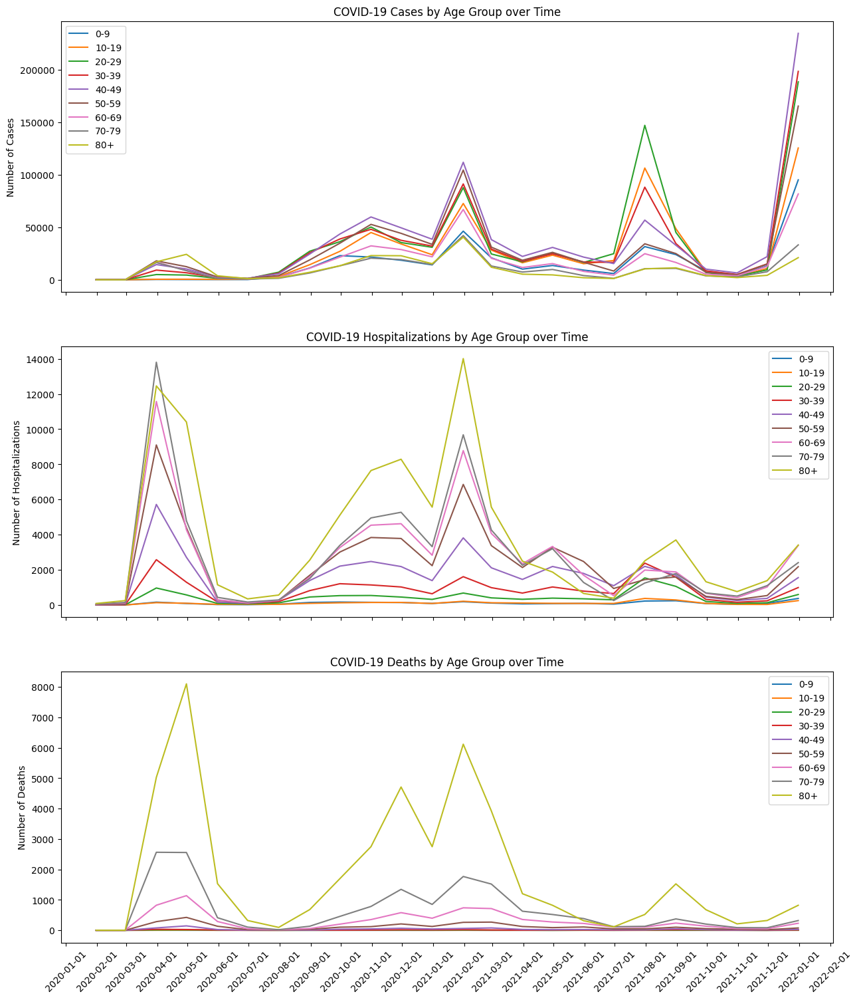

In [34]:
#Create a line graph for each metric and age group
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(15, 18), sharex=True)
for i, metric in enumerate(["Cases", "Hospitalizations", "Deaths"]):
    ax = axs[i]
    for age_group in covid_data["Age_Groups"].unique():
        data = covid_data.loc[covid_data["Age_Groups"] == age_group].groupby("Date").sum()[metric]
        data = data.resample('M').sum() #Group data by month
        ax.plot(data.index, data.values, label=age_group)
    #Add axis labels, title and legend
    ax.set_ylabel(f"Number of {metric}")
    ax.set_title(f"COVID-19 {metric} by Age Group over Time")
    ax.legend()

#Display only the start date of each month on the x-axis of the last subplot
axs[-1].xaxis.set_major_locator(mdates.MonthLocator(interval=1)) #Display ticks every month
axs[-1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-01')) #Format tick labels as first day of each month

#Rotate the x-axis tick labels for better readability
plt.xticks(rotation=45)

#Show the plots
plt.show()

The three graphs illustrate the progression of COVID-19 from the beginning of 2020 to the end of 2022. The first graph, which displays the number of cases, shows three main peaks: the first one occurring on January 1st, 2021, the second on July 1st, 2021, and the last one on January 1st, 2022. It is noticeable that each peak is higher than the previous one, with the last peak reaching approximately three times the number of cases in the first one. The worst age group affected differs for each peak, with the 40-49 age group being the most affected during the first and third wave, while the 20-29 age group was most affected during the second peak.

The second graph, which displays the number of hospitalizations, shows more peaks than the first one, and it indicates that the most hospitalized age groups are the older ones, specifically the 70-79 and 80+ age groups. Conversely, the 10-19 and 20-29 age groups have the lowest hospitalization rates. The graph also shows that at the beginning of the pandemic, all age groups had the highest hospitalization rates due to the lack of vaccine, and then gradually decreased.

The third graph, which displays the number of deaths, has the highest peak at the beginning of the pandemic, with the highest number of deaths being among the 80+ age group compared to all other age groups. It is evident that older people were more affected than younger ones, as the gap between the 80+ age group and all other age groups is significant.

Overall, the graphs show that the COVID-19 pandemic has significantly impacted all age groups, with the older population being the most vulnerable. However, the expansion of vaccination has helped reduce the number of hospitalizations and deaths, particularly among the older population. 

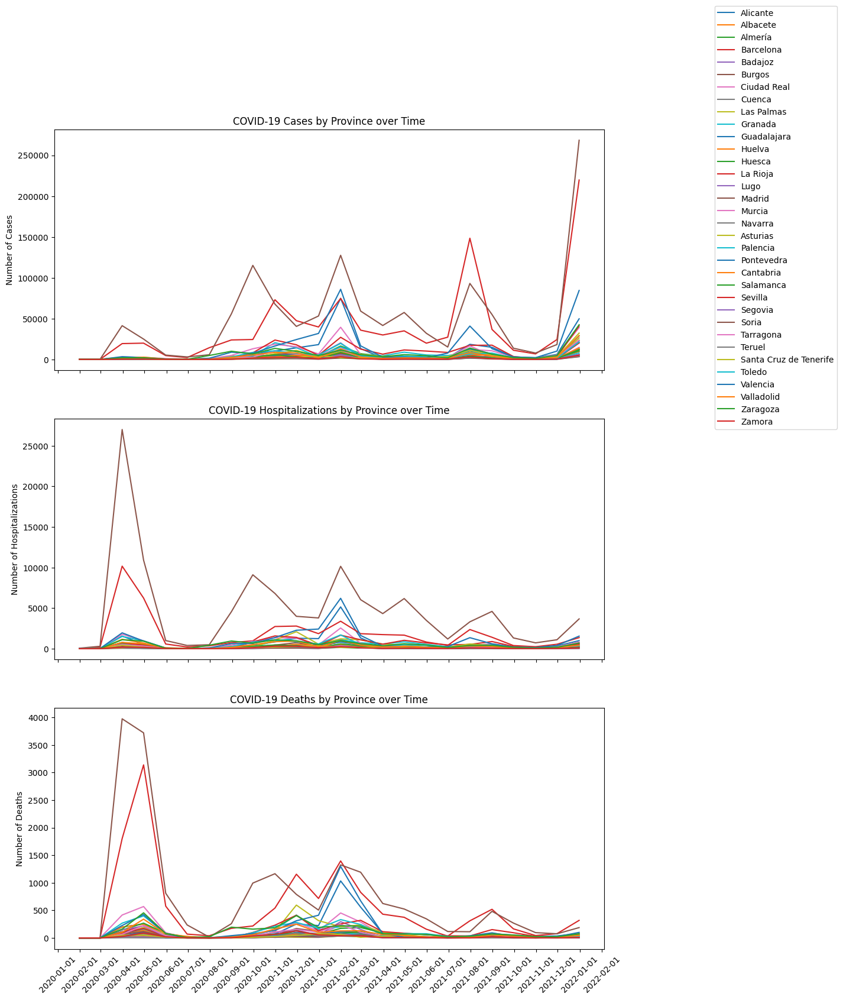

In [35]:
#Create a line graph for each metric and province
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(12, 18), sharex=True)
handles, labels = [], [] #Create empty lists to store handles and labels for the legend
for i, metric in enumerate(["Cases", "Hospitalizations", "Deaths"]):
    ax = axs[i]
    for province in covid_data["Province"].unique():
        data = covid_data.loc[covid_data["Province"] == province].groupby("Date").sum()[metric]
        data = data.resample('M').sum() #Group data by month
        line, = ax.plot(data.index, data.values, label=province)
        if i == 0: # only add one set of handles and labels to the legend
            handles.append(line)
            labels.append(province)
    #Add axis labels and title
    ax.set_ylabel(f"Number of {metric}")
    ax.set_title(f"COVID-19 {metric} by Province over Time")

#Display only the start date of each month on the x-axis of the last subplot
axs[-1].xaxis.set_major_locator(mdates.MonthLocator(interval=1)) #Display ticks every month
axs[-1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-01')) #Format tick labels as first day of each month

#Rotate the x-axis tick labels for better readability
plt.xticks(rotation=45)

#Create a legend for all three subplots on the right side
fig.legend(handles, labels, loc='upper left', bbox_to_anchor=(1.05, 1), ncol=1)

#Show the plots
plt.show()

The three graphs depict the temporal evolution of COVID-19 cases, hospitalizations, and deaths across different Spanish provinces. The first graph shows that the number of cases has three main peaks, similar to the age group graphs, with two more peaks at the beginning of the pandemic. Barcelona has the highest number of cases, especially during the last peak in January 2022.

The second graph displays the number of hospitalizations, and it shows that Madrid has the highest peak in March 2020, which is consistent throughout all peaks. It suggests that Madrid was the most affected province during the early stages of the pandemic.

The third graph indicates that the number of deaths is highest at the beginning of the pandemic, as expected due to the lack of vaccine. Interestingly, two provinces, Madrid and Barcelona, have the highest death rates compared to the other provinces. This trend could be attributed to their high population densities and the large number of cases during the pandemic.

Overall, the three graphs illustrate the impact of COVID-19 across different Spanish provinces. While all provinces have been affected, some, such as Madrid and Barcelona, have experienced higher rates of cases, hospitalizations, and deaths. 

### Heatmap - Cases/hosp/deaths for provinces and age groups

The second part of the analysis about COVID is done through the use of heat maps. Initially the COVID cases are analysed in relation to the age groups (0-9, 10-19, 20-29, 30-39, 40-49, 50-59, 60-69, 70-79, 80+). This is followed by the same process for the hospitalizations and finally for the deaths due to the virus, therefore generating a total of 27 graphs. 

First, the code creates a list of age groups present in the data using the `unique()` method.

Then, the code enters a loop that iterates over each age group in the list of age groups. For each age group, the code filters the data to include only the data related to the current age group. The filtered data is grouped by province, latitude, and longitude and the total cases for each province are calculated using the `sum()` method. The code then creates a Folium map centered on the first province in the `df_grouped` dataframe. The code creates a heatmap layer using the `HeatMap` function from Folium plugins. The heatmap layer is made using the `Latitude`, `Longitude`, and `Cases` columns of the `df_grouped` dataframe. Consequently, The code creates a legend that displays the age group being shown on the map. 

Finally, the map is displayed using the `display()` function.

The following shows the Spanish map with a focus on the provinces with the total amount of cases for each age group.

In [36]:
#Create a list of age groups
age_groups = covid_data['Age_Groups'].unique()

#Iterate over the age groups and create a map for each age group
for age_group in age_groups:
    #Filter the data to only include the current age group
    df = covid_data[covid_data['Age_Groups'] == age_group]

    #Group the data by province and calculate the total cases
    df_grouped = df.groupby(['Province', 'Latitude', 'Longitude'])['Cases'].sum().reset_index()

    #Create a map centered on the first province in the dataframe
    m = folium.Map(location=[df_grouped['Latitude'].iloc[0], df_grouped['Longitude'].iloc[0]], zoom_start=6)

    #Create a heatmap layer using the total cases and the latitude and longitude coordinates of each province
    heat_data = [[row['Latitude'], row['Longitude'], row['Cases']] for index, row in df_grouped.iterrows()]
    heatmap_layer = folium.plugins.HeatMap(heat_data)

    #Add the heatmap layer to the map
    heatmap_layer.add_to(m)
    
    #Create a legend displaying the age group being shown
    legend_html = f"<div style='position: fixed; bottom: 50px; left: 50px; width: 150px; height: 30px; border:2px solid grey; z-index:9999; background-color: rgba(255, 255, 255, 0.8);'>{age_group}</div>"
    #Show the map
    display(m)

The following nine maps show the provinces with the total amount of hospitalizations for each age group.

In [37]:
#Create a list of age groups
age_groups = covid_data['Age_Groups'].unique()

#Iterate over the age groups and create a map for each age group
for age_group in age_groups:
    #Filter the data to only include the current age group
    df = covid_data[covid_data['Age_Groups'] == age_group]

    #Group the data by province and calculate the total hospitalizations
    df_grouped = df.groupby(['Province', 'Latitude', 'Longitude'])['Hospitalizations'].sum().reset_index()

    #Create a map centered on the first province in the dataframe
    m = folium.Map(location=[df_grouped['Latitude'].iloc[0], df_grouped['Longitude'].iloc[0]], zoom_start=6)

    #Create a heatmap layer using the total hospitalizations and the latitude and longitude coordinates of each province
    heat_data = [[row['Latitude'], row['Longitude'], row['Hospitalizations']] for index, row in df_grouped.iterrows()]
    heatmap_layer = folium.plugins.HeatMap(heat_data)

    #Add the heatmap layer to the map
    heatmap_layer.add_to(m)
    
    #Create a legend displaying the age group being shown
    legend_html = f"<div style='position: fixed; bottom: 50px; left: 50px; width: 150px; height: 30px; border:2px solid grey; z-index:9999; background-color: rgba(255, 255, 255, 0.8);'>{age_group}</div>"
    #Show the map
    display(m)


The following shows the map of the provinces with the total amount of deaths for each age group.

In [38]:
#Create a list of age groups
age_groups = covid_data['Age_Groups'].unique()

#Iterate over the age groups and create a map for each age group
for age_group in age_groups:
    #Filter the data to only include the current age group
    df = covid_data[covid_data['Age_Groups'] == age_group]

    #Group the data by province and calculate the total deaths
    df_grouped = df.groupby(['Province', 'Latitude', 'Longitude'])['Deaths'].sum().reset_index()

    #Create a map centered on the first province in the dataframe
    m = folium.Map(location=[df_grouped['Latitude'].iloc[0], df_grouped['Longitude'].iloc[0]], zoom_start=6)

    #Create a heatmap layer using the total deaths and the latitude and longitude coordinates of each province
    heat_data = [[row['Latitude'], row['Longitude'], row['Deaths']] for index, row in df_grouped.iterrows()]
    heatmap_layer = folium.plugins.HeatMap(heat_data)

    #Add the heatmap layer to the map
    heatmap_layer.add_to(m)
    
    #Create a legend displaying the age group being shown
    legend_html = f"<div style='position: fixed; bottom: 50px; left: 50px; width: 150px; height: 30px; border:2px solid grey; z-index:9999; background-color: rgba(255, 255, 255, 0.8);'>{age_group}</div>"
    #Show the map
    display(m)


The heatmaps for COVID-19 cases, hospitalizations, and deaths across different age groups in Spanish provinces show some interesting trends.

The first heatmap for cases indicates that Barcelona and Madrid are the provinces with the highest concentration of cases, followed by Alicante. It's noteworthy that Navarra appears to be relevant for the age group 10-19, indicating that younger individuals in this province have been more affected by COVID-19.

The second heatmap for hospitalizations shows that Madrid has a much higher concentration of hospitalizations compared to Barcelona, which was surprising. Alicante is also relevant in this regard, indicating that individuals in this province have a higher likelihood of being hospitalized.

The third heatmap for deaths follows a similar trend to hospitalizations, with Madrid having the highest concentration of deaths followed by Alicante for the age group 0-9. Barcelona becomes more relevant for deaths in the age group 10-19, but it is low for the age groups 20-29, 30-39, and 40-49. For individuals aged 80+, Barcelona is significant but not as much as Madrid.

### Choropleth - Cases/hosp/deaths per provinces

In order to use this type of visualizations, the latitude and longitude values must be corrected so that the names of each province matches both in spelling and name. 

In [39]:
province_names = df_grouped['Province'].unique()
province_names

array(['Albacete', 'Alicante', 'Almería', 'Asturias', 'Badajoz',
       'Barcelona', 'Burgos', 'Cantabria', 'Ciudad Real', 'Cuenca',
       'Granada', 'Guadalajara', 'Huelva', 'Huesca', 'La Rioja',
       'Las Palmas', 'Lugo', 'Madrid', 'Murcia', 'Navarra', 'Palencia',
       'Pontevedra', 'Salamanca', 'Santa Cruz de Tenerife', 'Segovia',
       'Sevilla', 'Soria', 'Tarragona', 'Teruel', 'Toledo', 'Valencia',
       'Valladolid', 'Zamora', 'Zaragoza'], dtype=object)

In [40]:
#The json file was found here: https://github.com/codeforgermany/click_that_hood/blob/main/public/data/spain-provinces.geojson
#Load the GeoJSON data
with open('spain-provinces.geojson') as f:
    geojson_data = json.load(f)

for feature in geojson_data['features']:
    print(feature['properties']['name'])

Illes Balears
Asturias
A Coruña
Girona
Las Palmas
Pontevedra
Santa Cruz De Tenerife
Cantabria
Málaga
Almería
Murcia
Albacete
Ávila
Araba/Álava
Badajoz
Alacant/Alicante
Ourense
Barcelona
Burgos
Cáceres
Cádiz
Castelló/Castellón
Ciudad Real
Jaén
Córdoba
Cuenca
Granada
Guadalajara
Gipuzkoa/Guipúzcoa
Huelva
Huesca
León
Lleida
La Rioja
Soria
Navarra
Ceuta
Lugo
Madrid
Palencia
Salamanca
Segovia
Sevilla
Toledo
Tarragona
Teruel
València/Valencia
Valladolid
Bizkaia/Vizcaya
Zamora
Zaragoza
Melilla


In order to avoid errors in the code, the province's names must match so that the names in the original dataset provide no difference from the names in the GeoJSON dataset. 

In [41]:
df_grouped['Province'] = df_grouped['Province'].replace({
    'Alicante': 'Alacant/Alicante',
    'Castellón': 'Castelló/Castellón',
    'Guipúzcoa': 'Gipuzkoa/Guipúzcoa',
    'Valencia': 'València/Valencia',
    'Vizcaya': 'Bizkaia/Vizcaya', 
    'Islas Baleares': 'Illes Balears' ,
    'Gerona': 'Girona',
    'La Coruña': 'A Coruña',
    'Lérida': 'Lleida' ,
    'Orense': 'Ourense', 
    'Santa Cruz de Tenerife': 'Santa Cruz De Tenerife'
})
df_grouped.Province.unique()

array(['Albacete', 'Alacant/Alicante', 'Almería', 'Asturias', 'Badajoz',
       'Barcelona', 'Burgos', 'Cantabria', 'Ciudad Real', 'Cuenca',
       'Granada', 'Guadalajara', 'Huelva', 'Huesca', 'La Rioja',
       'Las Palmas', 'Lugo', 'Madrid', 'Murcia', 'Navarra', 'Palencia',
       'Pontevedra', 'Salamanca', 'Santa Cruz De Tenerife', 'Segovia',
       'Sevilla', 'Soria', 'Tarragona', 'Teruel', 'Toledo',
       'València/Valencia', 'Valladolid', 'Zamora', 'Zaragoza'],
      dtype=object)

The code creates choropleth maps using Plotly's `choropleth_mapbox` type of visualization to display COVID-19 cases by province for each age group in Spain.

First, the code loads a GeoJSON file containing the geographic regions to display on the map using the `open` and `json.load` functions. The file `spain-provinces.geojson` is used for this purpose.

Then, the code iterates over the unique age groups in the `covid_data` DataFrame using a for loop, which filters the `covid_data` DataFrame to only include the current age group. It groups the filtered DataFrame by province and calculates the total cases for each province using the `groupby` and `sum` functions. 

The code then creates a choropleth map using `px.choropleth_mapbox`. This function takes several arguments to customize the map, such as the DataFrame containing the data to display (`df_grouped`), the GeoJSON data for the geographic regions (`geojson_data`), the name of the column containing the province names (`locations`), the name of the key in the GeoJSON file that corresponds to the province names (`featureidkey`), the column to use for the color scale (`color`), the color scale to use (`color_continuous_scale`), the range of values to display on the color scale (`range_color`), the style of the map (`mapbox_style`), the initial zoom level and center of the map (`zoom` and `center`), the opacity of the map (`opacity`), and the labels to use for the legend (`labels`).

Finally, the code updates the layout of the figure with a title showing the current age group and displays the resulting map using the `show` function. 

The following maps show the **cases** for the different age groups.

In [42]:
#Create a list of age groups
age_groups = covid_data['Age_Groups'].unique()

#Load the GeoJSON data for the geographic regions to display on the map
with open('spain-provinces.geojson') as f:
    geojson_data = json.load(f)

#Iterate over the age groups and create a map for each age group
for age_group in age_groups:
    #Filter the data to only include the current age group
    df = covid_data[covid_data['Age_Groups'] == age_group]

    #Group the data by province and calculate the total cases
    df_grouped = df.groupby(['Province', 'Latitude', 'Longitude'])['Cases'].sum().reset_index()

    #Create a choropleth mapbox centered on the first province in the dataframe
    fig = px.choropleth_mapbox(df_grouped, geojson=geojson_data, locations='Province', featureidkey='properties.name',
                           color='Cases',
                           color_continuous_scale='Reds',
                           range_color=(0, df_grouped['Cases'].max()),
                           mapbox_style='carto-positron',
                           zoom=4, center={"lat": df_grouped['Latitude'].iloc[0], "lon": df_grouped['Longitude'].iloc[0]},
                           opacity=0.5,
                           labels={'Cases': 'Total cases'},
                           )

    fig.update_layout(title_text=f"COVID-19 cases for age group {age_group}")
    fig.show()

The following maps show the hospitalizations for the different age groups.

In [43]:
#Create a list of age groups
age_groups = covid_data['Age_Groups'].unique()

#Load the GeoJSON data for the geographic regions to display on the map
with open('spain-provinces.geojson') as f:
    geojson_data = json.load(f)

#Iterate over the age groups and create a map for each age group
for age_group in age_groups:
    #Filter the data to only include the current age group
    df = covid_data[covid_data['Age_Groups'] == age_group]

    #Group the data by province and calculate the total cases
    df_grouped = df.groupby(['Province', 'Latitude', 'Longitude'])['Hospitalizations'].sum().reset_index()

    #Create a choropleth mapbox centered on the first province in the dataframe
    fig = px.choropleth_mapbox(df_grouped, geojson=geojson_data, locations='Province', featureidkey='properties.name',
                           color='Hospitalizations',
                           color_continuous_scale='Reds',
                           range_color=(0, df_grouped['Hospitalizations'].max()),
                           mapbox_style='carto-positron',
                           zoom=4, center={"lat": df_grouped['Latitude'].iloc[0], "lon": df_grouped['Longitude'].iloc[0]},
                           opacity=0.5,
                           labels={'Hospitalizations': 'Total hospitalizations'},
                           )

    fig.update_layout(title_text=f"COVID-19 hospitalizations for age group {age_group}")
    fig.show()


The following maps show the deaths for the different age groups. 

In [44]:
#Create a list of age groups
age_groups = covid_data['Age_Groups'].unique()

#Load the GeoJSON data for the geographic regions to display on the map
with open('spain-provinces.geojson') as f:
    geojson_data = json.load(f)

#Iterate over the age groups and create a map for each age group
for age_group in age_groups:
    #Filter the data to only include the current age group
    df = covid_data[covid_data['Age_Groups'] == age_group]

    #Group the data by province and calculate the total cases
    df_grouped = df.groupby(['Province', 'Latitude', 'Longitude'])['Deaths'].sum().reset_index()

    #Create a choropleth mapbox centered on the first province in the dataframe
    fig = px.choropleth_mapbox(df_grouped, geojson=geojson_data, locations='Province', featureidkey='properties.name',
                           color='Deaths',
                           color_continuous_scale='Reds',
                           range_color=(0, df_grouped['Deaths'].max()),
                           mapbox_style='carto-positron',
                           zoom=4, center={"lat": df_grouped['Latitude'].iloc[0], "lon": df_grouped['Longitude'].iloc[0]},
                           opacity=0.5,
                           labels={'Deaths': 'Total Deaths'},
                           )

    fig.update_layout(title_text=f"COVID-19 deaths for age group {age_group}")
    fig.show()


In terms of cases, Barcelona and Madrid show the highest concentrations across all age groups, followed by Alicante, Zaragoza, Murcia, and Sevilla. In the 80+ age group, Barcelona and Madrid remain the most relevant, while other provinces show a more balanced distribution of cases.

For hospitalizations, Madrid has the highest concentration for the 0-9 age group, followed by Barcelona, Murcia, Sevilla, and Zaragoza. As age increases, Barcelona becomes more relevant, and it keeps increasing in importance with age groups.

Regarding deaths, the amount is significantly higher for older people compared to younger people. In the 80+ age group, Barcelona and Madrid have the highest amounts, followed by Zaragoza, Murcia, Granada, Sevilla, Toledo, Ciudad Real, Valladolid, and Asturias. Other provinces have less than 1000 deaths. Similar patterns are noticeable for lower age groups, where Barcelona and Madrid have the highest amounts, followed by Zaragoza, Sevilla, and Granada for the 20-29 and 30-39 age groups.

Overall, the choropleth maps provide an insight into the geographical distribution of COVID-19 cases, hospitalizations, and deaths across Spanish provinces, highlighting the concentration of these events in specific areas and age groups.

### Bokeh 

In the following section the code creates a vertical bar chart using the `Bokeh` library to display the total number of COVID-19 cases, hospitalizations, and deaths by province. It first groups the data by province and calculates the `sum` of cases, hospitalizations, and deaths. It then defines the data source and figure, sets the `range` and `labels` for the x and y axes, and formats the y-axis tick labels to display as comma-separated integers. The data is plotted using the `vbar_stack` method, which stacks the bars for each category (cases, hospitalizations, deaths) for each province. The `HoverTool` is added to provide tooltips with province-specific data when hovering over the bars. Finally, the x-axis labels are rotated by 45 degrees and the plot is saved as an HTML file and displayed in another tab using the `show` method.

In [45]:
import plotly.io as pio
#Define the province_data to consider the sum of cases, hospitalizations and deaths by province
province_data = covid_data.groupby(['Province']).agg({'Cases': 'sum', 'Hospitalizations': 'sum', 'Deaths': 'sum'}).reset_index()

#Define the data source
source = ColumnDataSource(province_data)

#Define the figure
p = figure(
    x_range=province_data["Province"],
    y_range=(0, max(province_data[["Cases", "Hospitalizations", "Deaths"]].max())+100),
    outer_width=1000,
    outer_height=800,
    title="Province Data",
    x_axis_label="Province",
    y_axis_label="Amount")

p.yaxis.formatter = NumeralTickFormatter(format="0,0")  #Format as comma-separated integers

#Plot the data
p.vbar_stack(
    stackers=["Cases", "Hospitalizations", "Deaths"],
    x="Province",
    width=0.9,
    color=["#CAB2D6", "#B2DF8A", "#FB8072"],
    source=source,
    legend_label=["Cases", "Hospitalizations", "Deaths"]
)


#Add hover tool
hover = HoverTool(
    tooltips=[
        ("Province", "@Province"),
        ("Cases", "@Cases"),
        ("Hospitalizations", "@Hospitalizations"),
        ("Deaths", "@Deaths")
    ]
)
p.add_tools(hover)

#Rotate the x-axis labels by 45 degrees
p.xaxis.major_label_orientation = 45


#Show the plot
output_file("province_data.html")
show(p)
#pio.write_html(fig, file='bokeh.html', auto_open=True)


## Part 2: Tourism in Spanish Provinces 

The initial analysis is done on the both precovid and post covid dataset. We use different types of visualisations to obtain different insights on the datasets. The visualisations are the following:
- Line graphs
- Choropleth maps
- Bar graphs

### Line graph - Tourism pre covid and post covid

We start our analysis by plotting a line graph of the Pre-covid period(July-December 2019) and Post-covid period (July-December 2021) to see if impact covid had on the number of  tourists arriving in Spain 

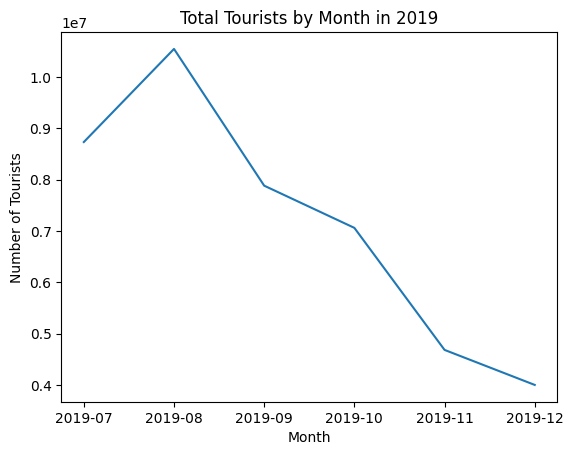

In [46]:
# group by month and sum the number of tourists
tourist = precovid_tourism_data.groupby('month')['tourists_number'].sum()

# create line chart
plt.plot(tourist.index, tourist.values)

# set title and axis labels
plt.title('Total Tourists by Month in 2019')
plt.xlabel('Month')
plt.ylabel('Number of Tourists')

# show the plot
plt.show()

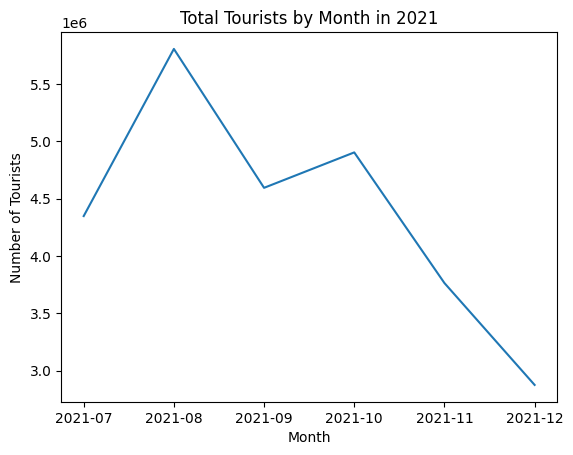

In [47]:
import pandas as pd
import matplotlib.pyplot as plt

# group by month and sum the number of tourists
tourist = postcovid_tourism_data.groupby('month')['tourists_number'].sum()

# create line chart
plt.plot(tourist.index, tourist.values)

# set title and axis labels
plt.title('Total Tourists by Month in 2021')
plt.xlabel('Month')
plt.ylabel('Number of Tourists')

# show the plot
plt.show()



We notice that in the first graph, which is the pre-covid period, there is an increase in the number of tourists arriving in August, after which we see a gradual decrease in the number of tourist arrivals in Spain.

A similar graph is observed in the post-covid period, here significant increase is observed in August and September 2021, then a gradual decrease in the number of tourist arrivals.

### Choropleth - Tourist home countries

In this section, we analyze to draw insights about where the tourists are coming from both in Pre-covid period and Post-covid period.

We  use the world-countries.json file from the data folder of the plotly library to extract the names of countries.
This will be used later to create a Choropleth map of the countries using a Plotly library.

In [48]:
import requests
import json

url = 'https://raw.githubusercontent.com/johan/world.geo.json/master/countries.geo.json'
r = requests.get(url)

data = json.loads(r.text)

with open('world-countries.json', 'w') as f:
    json.dump(data, f)

countries = []
for feature in data['features']:
    country_name = feature['properties']['name']
    countries.append(country_name)

print(countries)

['Afghanistan', 'Angola', 'Albania', 'United Arab Emirates', 'Argentina', 'Armenia', 'Antarctica', 'French Southern and Antarctic Lands', 'Australia', 'Austria', 'Azerbaijan', 'Burundi', 'Belgium', 'Benin', 'Burkina Faso', 'Bangladesh', 'Bulgaria', 'The Bahamas', 'Bosnia and Herzegovina', 'Belarus', 'Belize', 'Bermuda', 'Bolivia', 'Brazil', 'Brunei', 'Bhutan', 'Botswana', 'Central African Republic', 'Canada', 'Switzerland', 'Chile', 'China', 'Ivory Coast', 'Cameroon', 'Democratic Republic of the Congo', 'Republic of the Congo', 'Colombia', 'Costa Rica', 'Cuba', 'Northern Cyprus', 'Cyprus', 'Czech Republic', 'Germany', 'Djibouti', 'Denmark', 'Dominican Republic', 'Algeria', 'Ecuador', 'Egypt', 'Eritrea', 'Spain', 'Estonia', 'Ethiopia', 'Finland', 'Fiji', 'Falkland Islands', 'France', 'Gabon', 'United Kingdom', 'Georgia', 'Ghana', 'Guinea', 'Gambia', 'Guinea Bissau', 'Equatorial Guinea', 'Greece', 'Greenland', 'Guatemala', 'French Guiana', 'Guyana', 'Honduras', 'Croatia', 'Haiti', 'Hunga

Now that we have the list of countries, let us plot a choropleth map to understand which country is the most tourists come from

In [49]:
# Group the data by origin country and sum the number of tourists
df_grouped = precovid_tourism_data.groupby(['Origin_country']).sum().reset_index()

# Plot the choropleth map
fig = px.choropleth(df_grouped, locations='Origin_country', locationmode='country names', color='tourists_number',
                    title='Tourist Origin Countries in Pre-covid period', projection='natural earth', range_color=(0, df_grouped['tourists_number'].max()))

fig.show()



For easier understanding, we plot the bar graph in descending order of countries that most tourists are coming from.

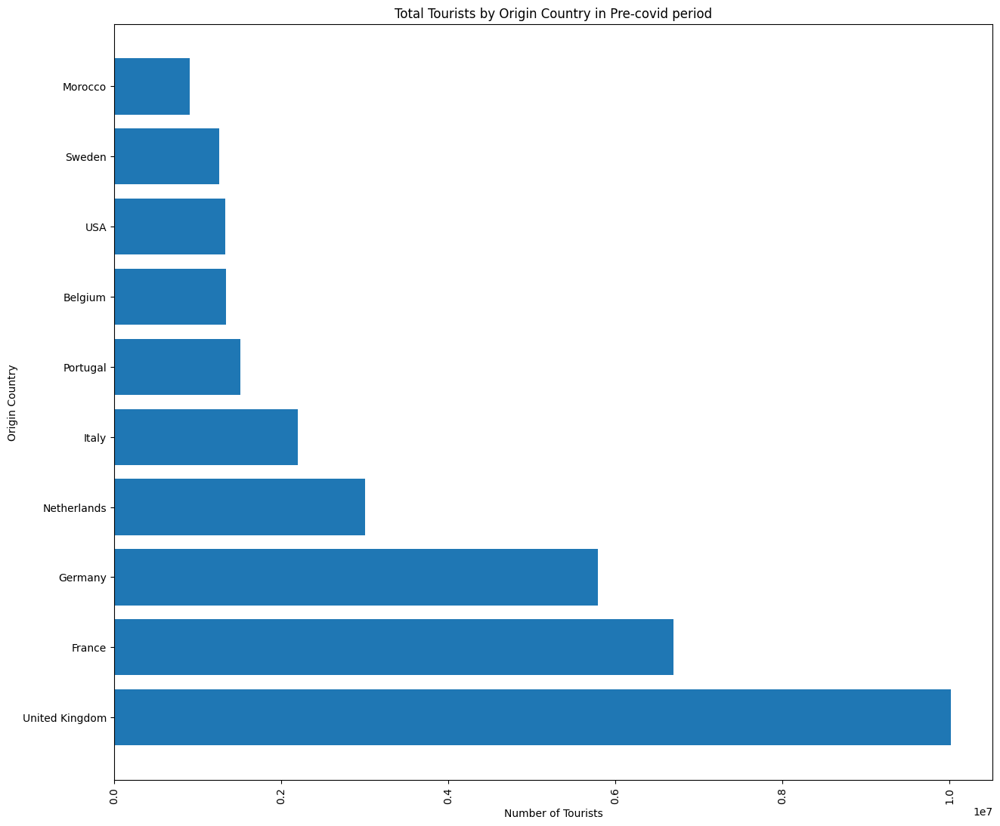

In [50]:
# group by origin country and sum the number of tourists
precovidtourist_origin = precovid_tourism_data.groupby('Origin_country')['tourists_number'].sum()
# sort by descending order
precovidtourist_origin = precovidtourist_origin.sort_values(ascending=False)
precovidtourist_origin = precovidtourist_origin[:10]
plt.figure(figsize=(15, 13))
plt.barh(precovidtourist_origin.index, precovidtourist_origin.values)

plt.title('Total Tourists by Origin Country in Pre-covid period')
plt.xlabel('Number of Tourists')
plt.ylabel('Origin Country')
plt.xticks(rotation=90)
plt.show()


In [51]:
# Group the data by origin country and sum the number of tourists
df_grouped = postcovid_tourism_data.groupby(['Origin_country']).sum().reset_index()

# Plot the choropleth map
fig = px.choropleth(df_grouped, locations='Origin_country', locationmode='country names', color='tourists_number',
                    title='Tourist Origin Countries in Post-covid period', projection='natural earth')

fig.show()

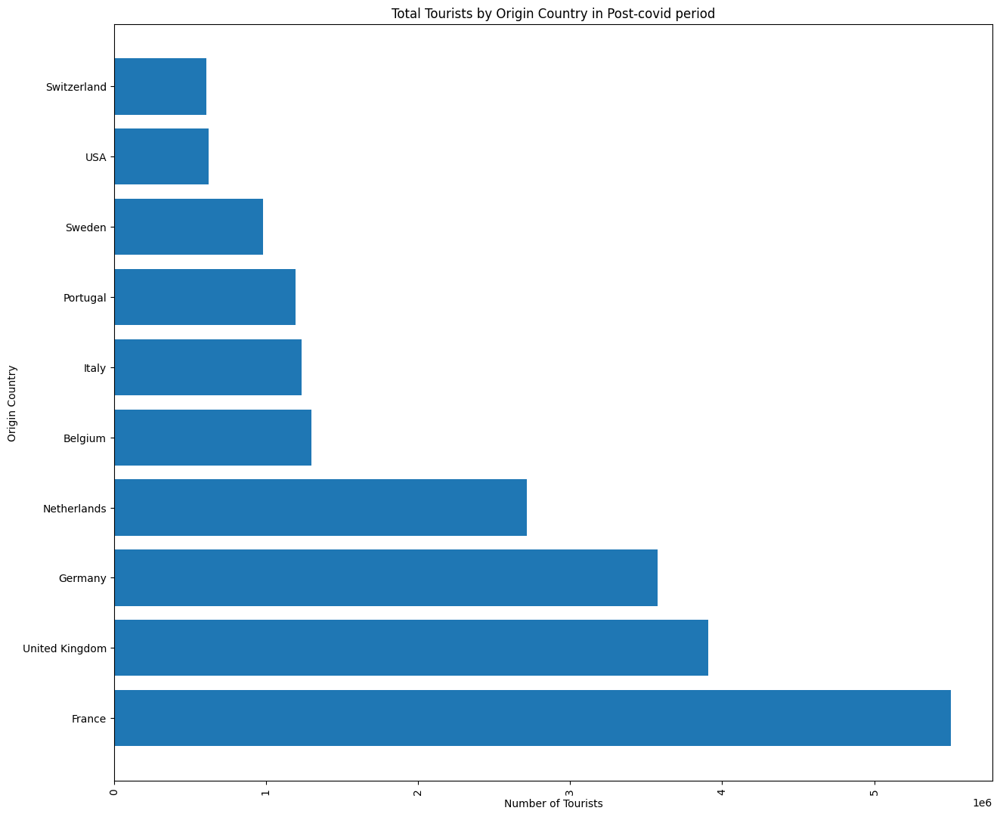

In [52]:
# group by origin country and sum the number of tourists
postcovidtourist_origin = postcovid_tourism_data.groupby('Origin_country')['tourists_number'].sum()
# sort by descending order
postcovidtourist_origin = postcovidtourist_origin.sort_values(ascending=False)
postcovidtourist_origin = postcovidtourist_origin[:10]
plt.figure(figsize=(15, 13))
plt.barh(postcovidtourist_origin.index, postcovidtourist_origin.values)

plt.title('Total Tourists by Origin Country in Post-covid period')
plt.xlabel('Number of Tourists')
plt.ylabel('Origin Country')
plt.xticks(rotation=90)
plt.show()

In the pre-covid perid, both the choropleth map and the bar graph show that the majority of tourists come from countries such as the United Kingdom, France, Germany, the Netherlands, Italy, Portugal, Belgium, the United States, Sweden, and Morocco.
The tourism business in Spain appears to be primarily reliant on visitors from a few  European nations,  the United States and Morocco. This data can help tourism agencies and businesses in Spain direct their marketing efforts and resources to these nations to attract more visitors.


In the post-covid period, both visualizations reveal that the majority of tourists come from the same regions as in the pre-covid period, with the exception that the French outnumbered the British, and Morocco was replaced by Switzerland. 

### Choropleth - Inbound Spanish tourism

This section focuses on which provinces of Spain the tourists visited in pre-covid and post-covid periods.

We will plot a choropleth map and then a bar graph for drawing the insights easily.

In [53]:
import plotly.io as pio
# Load the GeoJSON data for the provinces of Spain
with open('spain-provinces.geojson') as f:
    geojson_data = json.load(f)

# Convert the GeoJSON data to a Pandas DataFrame
df_geojson = pd.json_normalize(geojson_data['features'])
df_geojson['destination_province'] = df_geojson['properties.name']

# Group the data by destination province and sum the number of tourists
df_grouped =  precovid_tourism_data.groupby(['Origin_country', 'Latitude', 'Longitude', 'destination_province'])['tourists_number'].sum().reset_index()


# Plot the choropleth map
fig = px.choropleth_mapbox(df_grouped, geojson=geojson_data, locations='destination_province', featureidkey='properties.name',
                           color='tourists_number',
                           mapbox_style='carto-positron', color_continuous_scale='Reds', range_color=(0, 150000),
                           center={"lat": df_grouped['Latitude'].iloc[0], "lon": df_grouped['Longitude'].iloc[0]},
                            zoom=4,
                           opacity=0.5,
                           labels={'tourists_number': 'Total tourists'})

fig.update_layout(title_text=f"Tourists visiting provinces in Spain pre-covid period")
pio.write_html(fig, file='precovid_spain_tourism_map.html', auto_open=True)
fig.show()

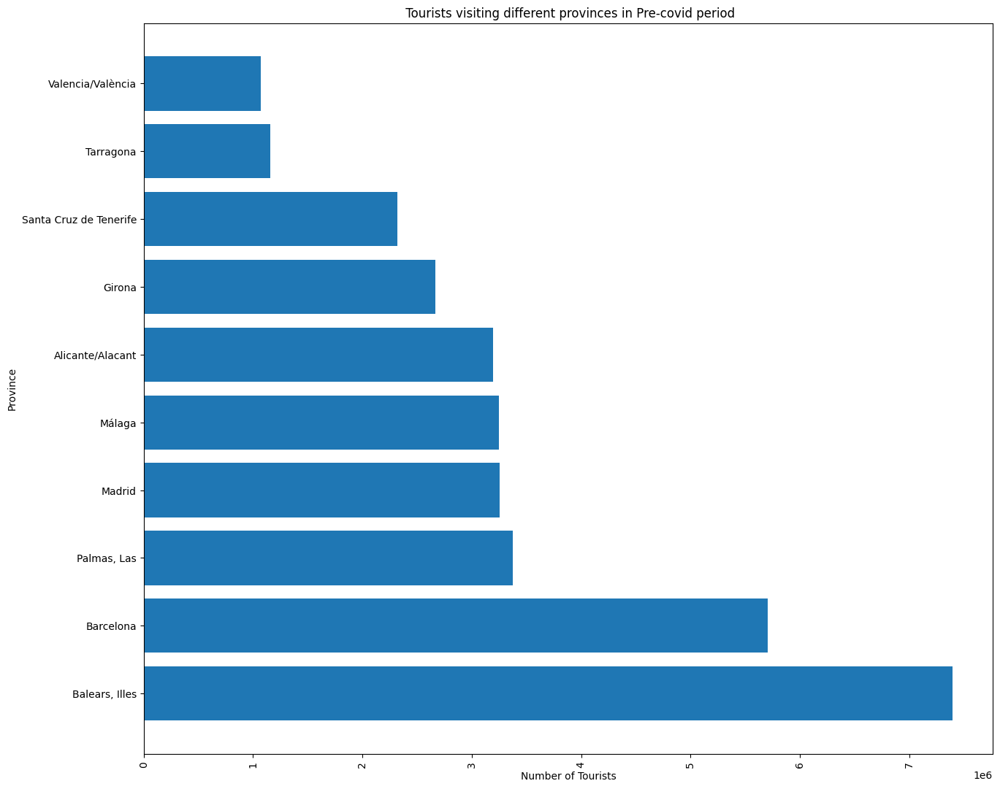

In [54]:

# group by province and sum the number of tourists
precovidtourist_origin = precovid_tourism_data.groupby('destination_province')['tourists_number'].sum()
# sort by descending order
precovidtourist_origin = precovidtourist_origin.sort_values(ascending=False)
precovidtourist_origin = precovidtourist_origin[:10]
plt.figure(figsize=(15, 13))
plt.barh(precovidtourist_origin.index, precovidtourist_origin.values)

plt.title(' Tourists visiting different provinces in Pre-covid period')
plt.xlabel('Number of Tourists')
plt.ylabel('Province')
plt.xticks(rotation=90)
plt.show()


In [55]:
# Load the GeoJSON data for the provinces of Spain
with open('spain-provinces.geojson') as f:
    geojson_data = json.load(f)

# Convert the GeoJSON data to a Pandas DataFrame
df_geojson = pd.json_normalize(geojson_data['features'])
df_geojson['destination_province'] = df_geojson['properties.name']

# Group the data by destination province and sum the number of tourists
df_grouped =  postcovid_tourism_data.groupby(['Origin_country', 'Latitude', 'Longitude', 'destination_province'])['tourists_number'].sum().reset_index()


# Plot the choropleth map
fig = px.choropleth_mapbox(df_grouped, geojson=geojson_data, locations='destination_province', featureidkey='properties.name',
                           color='tourists_number',
                           mapbox_style='carto-positron', color_continuous_scale='Reds', range_color=(0, 80000),
                           center={"lat": df_grouped['Latitude'].iloc[0], "lon": df_grouped['Longitude'].iloc[0]},
                            zoom=4,
                           opacity=0.5,
                           labels={'tourists_number': 'Total tourists'})

fig.update_layout(title_text=f"Tourists visiting provinces in Spain post-covid period")
pio.write_html(fig, file='postcovid_spain_tourism_map.html', auto_open=True)
fig.show()


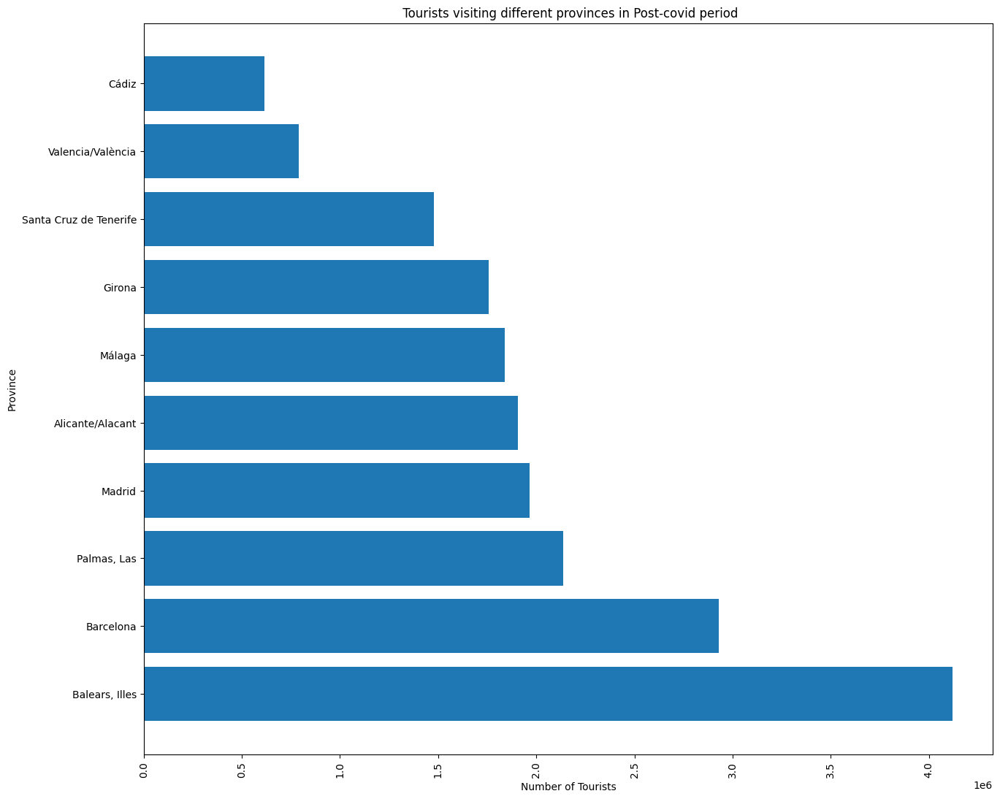

In [56]:
# group by province and sum the number of tourists
postcovidtourist_origin = postcovid_tourism_data.groupby('destination_province')['tourists_number'].sum()
# sort by descending order
postcovidtourist_origin = postcovidtourist_origin.sort_values(ascending=False)
postcovidtourist_origin = postcovidtourist_origin[:10]
plt.figure(figsize=(15, 13))
plt.barh(postcovidtourist_origin.index, postcovidtourist_origin.values)

plt.title(' Tourists visiting different provinces in Post-covid period')
plt.xlabel('Number of Tourists')
plt.ylabel('Province')
plt.xticks(rotation=90)
plt.show()


It's worth noting that the provinces of Balears, Illes, Barcelona, and Palmas de Mallorca were the most visited both before and during the COVID-19 pandemic. It's also worth noting that the order of the most visited provinces hasn't changed dramatically. This indicates that there were no significant emerging travel trends. The main difference is that the number of tourists visiting the Balearic Islands has decreased from 7 million to roughly 4.1 million, demonstrating the influence of COVID-19. This can be observed in other provinces as well.

## Part 3: The "successful" province

In order to find the Spanish province which managed to handle the tourism post-COVID as best as possible, the three datasets used so far in the project need to be merged.

In [57]:
#Keep data until the end of June 2021, before we consider the tourism post COVID
covid_data = covid_data[covid_data['Date'] <= '2021-06-30']
covid_data.tail()

,Province,Sex,Age_Groups,Date,Cases,Hospitalizations,Deaths,Latitude,Longitude
869714,Zamora,Female,40-49,2021-06-30,1,0,0,41.685769,-5.942315
869715,Zamora,Female,50-59,2021-06-30,1,0,0,41.685769,-5.942315
869716,Zamora,Female,60-69,2021-06-30,0,0,0,41.685769,-5.942315
869717,Zamora,Female,70-79,2021-06-30,0,0,0,41.685769,-5.942315
869718,Zamora,Female,80+,2021-06-30,0,0,0,41.685769,-5.942315


In [58]:
#Sum the cases per province in this period of time
CasesProv_Data = covid_data.groupby(['Province']).agg({'Cases': 'sum'}).reset_index()
#Sum the tourists per province both pre-COVID and post-COVID
PreCovidTourism_Data = precovid_tourism_data.groupby(['destination_province']).agg({'tourists_number': 'sum'}).reset_index()
PostCovidTourism_Data = postcovid_tourism_data.groupby(['destination_province']).agg({'tourists_number': 'sum'}).reset_index()

In [59]:
#Merge the three dataframes based on the common column "Province" and "destination_province"
merged_data = pd.merge(CasesProv_Data, PostCovidTourism_Data, left_on='Province', right_on='destination_province', how='inner')
merged_data = pd.merge(merged_data, PreCovidTourism_Data, left_on='Province', right_on='destination_province', how='inner')

#Select the desired columns and rename the columns
SuccProv_Data = merged_data[['Province', 'Cases', 'tourists_number_x', 'tourists_number_y']]
SuccProv_Data = SuccProv_Data.rename(columns={'tourists_number_x': 'Tourists_Post', 'tourists_number_y': 'Tourists_Pre'})

#Create a new column with the difference between Tourists_pre and Tourists_post
SuccProv_Data['Tourists_Difference'] = SuccProv_Data['Tourists_Pre'] - SuccProv_Data['Tourists_Post']

#Remove the Tourists_pre and Tourists_post columns
SuccProv_Data = SuccProv_Data.drop(['Tourists_Pre', 'Tourists_Post'], axis=1)

#Calculate the change in tourism per COVID case
SuccProv_Data['Tourists_Per_Case'] = SuccProv_Data['Tourists_Difference'] / SuccProv_Data['Cases']

#Sort the dataframe by the Tourists_per_case column in descending order
SuccProv_Data = SuccProv_Data.sort_values(by='Tourists_Per_Case', ascending=False)

#Show the results 
SuccProv_Data.head()

,Province,Cases,Tourists_Difference,Tourists_Per_Case
20,Santa Cruz de Tenerife,28964,839337,28.978629
24,Tarragona,55303,571928,10.341717
4,Barcelona,491386,2774698,5.646677
16,Navarra,15852,55617,3.508516
1,Almería,55794,184952,3.314908


A new column called `Tourists_per_case` is created by dividing the `Tourists_diff` column by the `Cases` column in the `SuccProv_Data` dataframe. This represents the change in tourism per COVID case. Then, the dataframe is sorted by the "Tourists_per_case" column in descending order, so that the provinces with the highest change in tourism per COVID case are at the top. Finally, the resulting dataframe is displayed with the new `Tourists_per_case` column. Based on the above changes to the dataframe, it can be seen that Santa Cruz de Tenerife is the "successfull province" as it presents the highest "tourism per case" value compared to the other provinces. It can be noticed how Santa Cruz de Tenerife is the absolute best among all the Spanish territoritories as it has almost three times the value compared to the second province, which is an impressive result.  

## Part 4: The attractions in the "successful province" 

In [61]:
import flickrapi
import time
import xml.etree.ElementTree as ET
from collections import defaultdict
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import cluster
from sklearn import preprocessing
import seaborn as sns
import folium
from folium.plugins import HeatMap

# your API key and secret
api_key = u'3a500e823f55613be4f5acee369d4041'
api_secret = u'b7ac06684cafe24f'

# creation of a FlickrAPI object
flickr = flickrapi.FlickrAPI(api_key, api_secret)

In this part, we are going to use  FlickrAPI to ascertain the locations within the Santa Cruz de Tenerife region where a higher number of photographs were taken, in light of the fact that this particular region exhibited a relatively swift recovery in tourism after the COVID-19 pandemic.

In [62]:
# create a default dictionary to store information about the photos
# the keys are the attributes of interest and the values the data
photo_info = defaultdict(list)
i = 1
while True:     
    result = flickr.photos.search(
                    per_page=400, #number of data per page
                    has_geo=1, #Photo that has geo location
                    min_taken_date='2020-3-14', 
                    max_taken_date='2022-4-01', 
                    bbox='-16.3022, 28.4233, -16.2229, 28.4853', # boundary box of tenerife
                    media='photos', #collecting only photos (videos excluded)
                    sort='date-taken-desc', 
                    privacy_filter=1,#collecting only public photos 
                    safe_search=1, #photos without violence
                    extras='geo,url_n,date_taken,views,license',
                    page=i)
    
    # pause the execution of the program 2 seconds
    time.sleep(2)
    
    # obtain the number of pages (first iteration)
    
    if i == 1:
        pages = int(result[0].attrib['pages'])
        print('Number of pages: {}'.format(pages))
    
    # print the number of the page - iteration of the while loop
    print(i, end=' ')  
    
    # loop through all the photos available in the page
    # store (1) the id, (2) the latitude, (3) the longitude, and (4) the URL of the photo in the dictionary  
    for element in result[0].findall('photo'):
        photo_info['id'].append(element.attrib['id'])
        photo_info['latitude'].append(element.attrib['latitude'])
        photo_info['longitude'].append(element.attrib['longitude'])
        photo_info['url_n'].append(element.attrib['url_n'])

    # if the page correspond to the last page we break the loop  
    if i == pages:
        break
    else:
        i = i + 1  

Number of pages: 4
1 2 3 4 

In [63]:
ET.dump(result[0])

<photos page="4" pages="3" perpage="250" total="743" />


In [64]:
# convert the dictionary into a Pandas dataframe
df_photo = pd.DataFrame(photo_info) 

# visualize the first 5 rows of the dataframe
df_photo.head()

,id,latitude,longitude,url_n
0,52081338627,28.463220,-16.247867,https://live.staticflickr.com/65535/5208133862...
1,52082839205,28.456146,-16.251397,https://live.staticflickr.com/65535/5208283920...
2,52014747148,28.464800,-16.247950,https://live.staticflickr.com/65535/5201474714...
3,52115473163,28.466800,-16.247867,https://live.staticflickr.com/65535/5211547316...
4,52227639516,28.467297,-16.247981,https://live.staticflickr.com/65535/5222763951...


In [65]:

df_photo['latitude'] = df_photo['latitude'].astype(float)
df_photo['longitude'] = df_photo['longitude'].astype(float)
# eliminate duplicated photos from the data set
df_photo = df_photo.drop_duplicates()

# size of the data set after removing duplicated photos
df_photo.shape



(750, 4)

In [66]:
# remove id and url_n columns from the data set
df_photo.drop(['id', 'url_n'], axis=1, inplace=True)
df_photo.to_csv('tenerife_photos.csv')

<AxesSubplot: title={'left': 'Location of the photographs taken in Santa Cruz de Tenerife during Covid'}, xlabel='longitude', ylabel='latitude'>

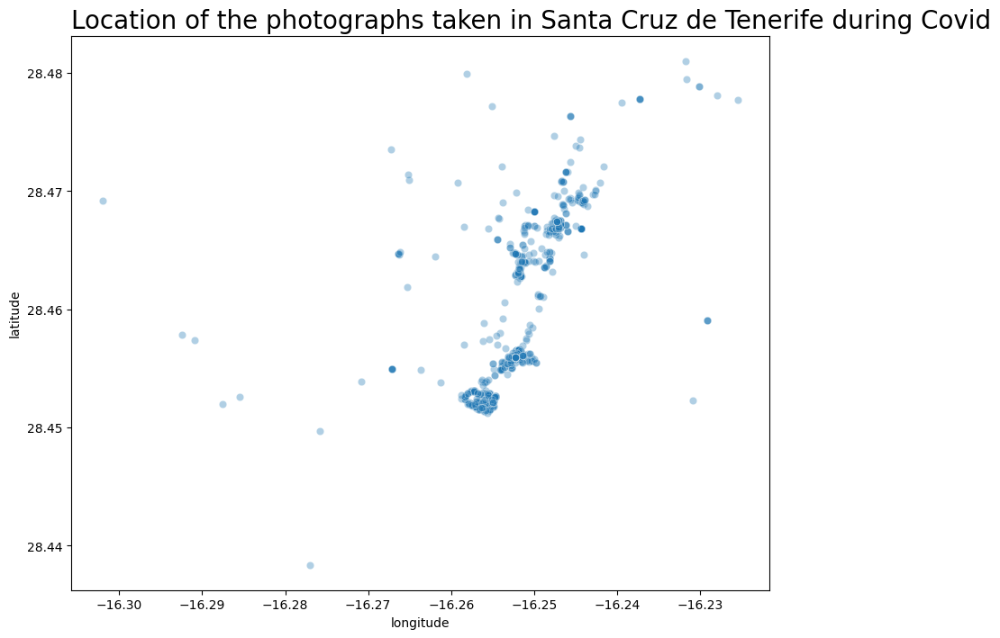

In [67]:
# visualization of the results using a scatter plot
fig = plt.figure(figsize=(10, 8))
plt.title('Location of the photographs taken in Santa Cruz de Tenerife during Covid', loc='left', fontsize=20)
sns.scatterplot(x=df_photo.longitude, y=df_photo.latitude, alpha=.35)

We will use DBSCAN which is a density-based clustering algorithm used for identifying closely packed data points and separating them into clusters. It can identify clusters of different shapes and sizes and handle noisy and sparse datasets. Unlike other clustering algorithms, it does not require the number of clusters to be specified beforehand.

<AxesSubplot: title={'left': 'Most popular tourist attractions in Santa Cruz de Tenerife - DBSCAN method'}, xlabel='longitude', ylabel='latitude'>

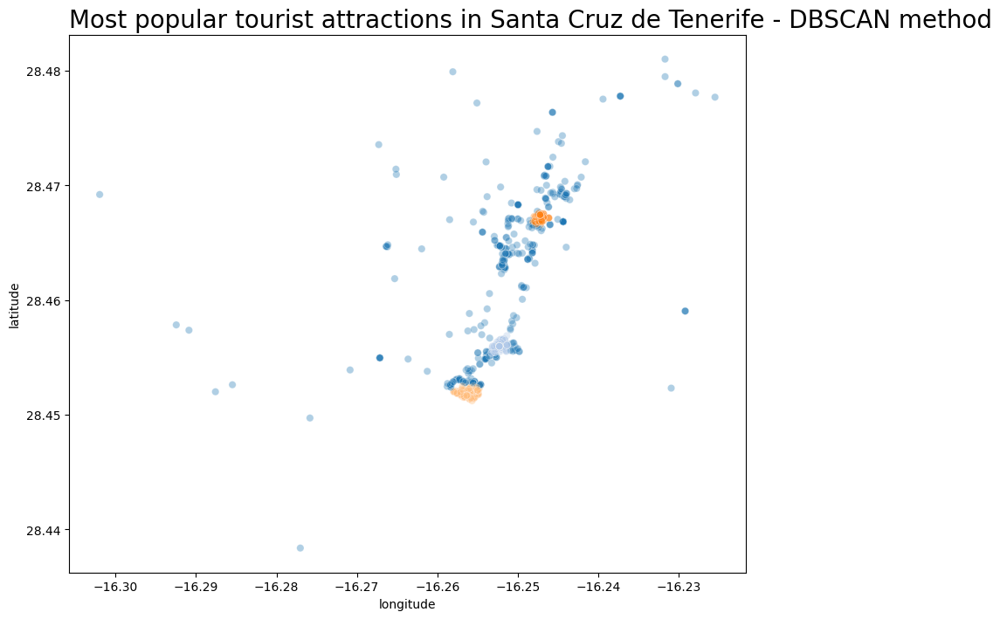

In [68]:
scaler = preprocessing.MinMaxScaler()

# normalization - fit and transform the data
df_photos_scaled = scaler.fit_transform(df_photo)

# apply the dbscan algorithm to the dataset
tourist_points = cluster.DBSCAN(eps=0.010, min_samples=35).fit(df_photos_scaled)

# labels of the clusters
labels_tourist_points = tourist_points.labels_

# visualization of the results with a scatter plot
fig = plt.figure(figsize=(10, 8))
plt.title('Most popular tourist attractions in Santa Cruz de Tenerife - DBSCAN method', loc='left', fontsize=20)
sns.scatterplot(x=df_photo.longitude, y=df_photo.latitude, alpha=.35,
                hue=labels_tourist_points, palette="tab20", legend=None)

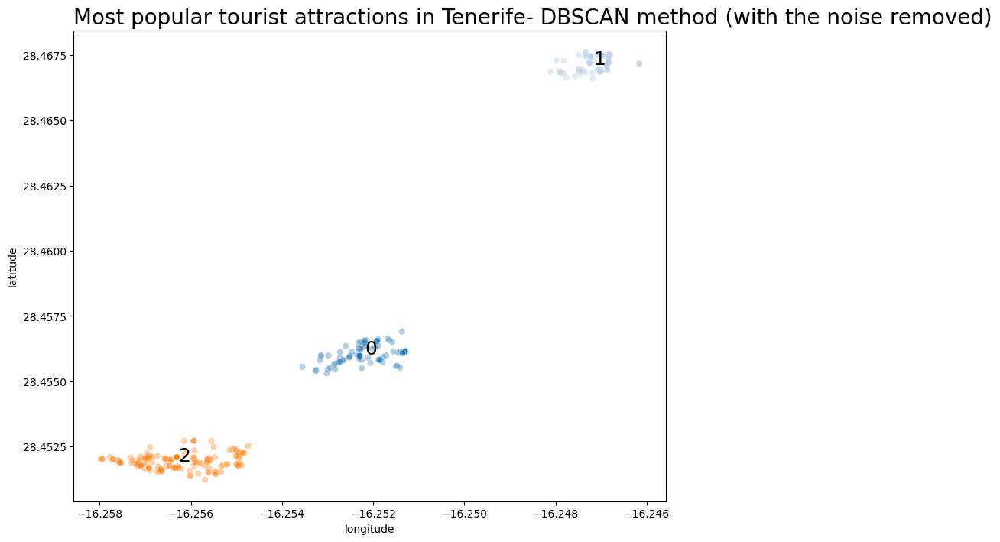

In [69]:
np.unique(labels_tourist_points)

df_photos_filtered = df_photo[tourist_points.labels_ != -1]

labels_tourist_points_filtered = labels_tourist_points[labels_tourist_points != -1]

# calculate the center of each cluster
mean_location_clusters = []
for group in np.unique(labels_tourist_points_filtered):
    mean_location_clusters.append(list(df_photos_filtered[labels_tourist_points_filtered==group].mean()))
# visualization of the results with a scatter plot
fig = plt.figure(figsize=(10, 8))
plt.title('Most popular tourist attractions in Tenerife- DBSCAN method (with the noise removed)', loc='left', fontsize=20)
sns.scatterplot(x=df_photos_filtered.longitude, y=df_photos_filtered.latitude, alpha=.35,
                hue=labels_tourist_points_filtered, palette="tab20", legend=None);

# visualize the label associated to each cluster
for index, location in enumerate(mean_location_clusters):
    plt.text(location[1], location[0], str(index), fontsize=18);

In [70]:
# creation of an empty map of Tenerife
from bokeh.io import output_file, save
tenerife_map = folium.Map(location=[28.2916, -16.6291], zoom_start=13)

# plot the locations of the center of the clusters
for index, location in enumerate(mean_location_clusters):
    folium.map.Marker(location=[location[0], location[1]],
                      icon=folium.plugins.BeautifyIcon(border_color='blue',
                                                       text_color='blue',
                                                       number=index,
                                                       icon_shape='marker')).add_to(tenerife_map)

# show the map
tenerife_map
#tenerife_map.save('tenerife_map.html')

From the map above we can see 5 most popular touristic attractions in Santa Cruz de Tenerife:

0:Castillo de San Juan Bautista (Castillo Negro)  a fortress from the 17 century

1:La Charca a very beautiful lake  surrounded by monuments

2: Palmetum of Santa Cruz a park with the best collection of palm trees in Europe

3: El rastro de santa cruz the largest street market on the island also surrounded by different historical monuments

4: Puerto de la Cruz the most popular and stunning port on the island 

# Conclusion

To elaborate, Santa Cruz de Tenerife region in Spain has been able to maintain a stable position in the tourism industry, even amidst the global COVID-19 pandemic. This can be attributed to the region's emphasis on outdoor tourism attractions, which have become increasingly popular as tourists seek safe and socially distant activities.

The region's natural landmarks and scenic sites have proven to be a draw for tourists seeking to explore and appreciate the diverse and visually striking natural environment. The natural attractions of the region have remained relatively unimpacted by pandemic-related restrictions, as visitors are able to explore and enjoy them while adhering to social distancing guidelines. Additionally, the region's tourism industry has adapted to the changing needs of visitors by offering activities such as hiking, cycling, and watersports, which allow for safe and socially distant outdoor recreation.

As a result, the Santa Cruz de Tenerife region has experienced comparatively lesser variation in tourist activity from pre-COVID to post-COVID, making it a promising location for the tourism industry in the years to come. The region's focus on outdoor tourism and appreciation for its natural environment has made it a resilient and attractive destination for tourists seeking a unique and safe travel experience.

# Genre 

The article written by Segel and Heer dives into the design space and organization of a website focused on the relationship between genres, visual narrative tactics as well narrative structure techniques. The website tells a story in a linear and easy-to-follow manner, using a magazine-style author-driven **genre** that characterizes the website's layout. This genre is characterized by a linear ordering of scenes due to the timeline that the project follows, and heavy messaging to help viewers understand possible insights and what they mean. While little to no interactivity is present, few graphs are used to show the number of cases, hospitalizations, and deaths per province in Spain, as well as the tourists visiting the country. These features are typical of the magazine-style genre for a website. However, due to the number of visualizations, the website also employs a “comic strip” approach to structure the content, which is pretty common, as these genres are not mutually exclusive.

The **visual narrative** tactics used in the website are essential in guiding readers through the website and discovering the story. The following are some of the key features that define the design of the website:
-	Within the *visual structuring* section, the authors employ a consistent visual platform to help readers orient themselves early on. The consistent use of design elements, such as color, typography, and layout, help to create a cohesive visual language throughout the website. This provides a sense of continuity and familiarity that helps readers navigate through the content more easily.
-	In the *highlighting* category, feature distinction is used to direct the viewer's attention to specific elements in the graphs and maps. By highlighting particular elements, the authors are able to draw the reader's attention to key insights that support the narrative.
-	In the *transition guidance* category, the authors use familiar objects while scrolling to maintain a linear structure and ensure readers don't lose interest. This technique helps to create a sense of movement and progress through the content, which is especially important when dealing with a linear narrative.

The **narrative structure** tactics used in the website also play a critical role in facilitating the narrative. The following are some of the key features that define the design of the website:
-	Because the *ordering* category refers to the arrangement for the readers to go through the visualization, a linear path was chosen in relation to the timeline that the project follows. This approach ensures that the reader can follow the story in a logical and easy-to-understand manner, allowing them to focus on the content and insights presented.
-	In the *interactivity* section, certain graphs are characterized by a hover tool to get more insights out of the visualizations. By using hover tools, the authors are able to provide additional information and context to readers who want to dive deeper into the data. 
-	In terms of *messaging*, the project is presented to the viewer through headlines to understand in what part of the project they are, and introductions, summaries, as well as explanations of each graph. These features help to contextualize the content and provide the reader with a clear understanding of what they're about to read. 

# Visualizations 

Explain the visualizations you've chosen.
Why are they right for the story you want to tell?

For our project, we chose the following visualizations
  - **Line graph:** Line graphs are widely used to demonstrate trends over time or correlations between two  variables.
  - **Choropleth maps:** A choropleth map is a form of themed map that displays data for geographic regions such as countries, states, or provinces. Shaded or colored patches represent the values of a specific variable.
  - **Heat maps:** A heat map is a form of a map in which colors are used to indicate data values.  Heat maps are frequently used to visualize data from large datasets such as website traffic or customer behavior.
  - **Bar graph:** Bar graphs are frequently used to compare numbers across categories or to demonstrate changes in data over time.
  - **Bokeh interactive graph:** Bokeh is useful because it can create linked visualizations, which connect multiple visualizations to provide a more comprehensive view of the data, as well as tools for creating interactive widgets, which allow users to interact with the data and adjust the visualization in real-time.

We used these visualizations as they allow the viewer to see at a glance the overall distribution of tourists across the provinces of Spain and also compare the popularity of different provinces simply and intuitively. The viewer can easily identify which provinces were the most popular tourist destinations and which ones were less popular.  This is significant for describing the story of post-covid tourism in Spain since it shows which areas were successful in luring visitors and which were not.
  
  
  
  
  


# Discussion 

Through our project, we conducted a detailed analysis of the impact of the COVID-19 pandemic on the tourism industry in Spain. Our findings were supported by a range of self-explanatory graphs and visual aids, which allowed for a more comprehensive understanding of the trends and patterns observed in the data Our analysis revealed the significant impact of the pandemic on the tourism industry in Spain, with a sharp decline in tourist activity observed in the early months of the outbreak. We further examined the impact of the pandemic on different regions and cities across the country, identifying variations in the extent of the decline depending on factors such as the nature of the tourism industry.

Despite the fact that our project provided a comprehensive analysis of the impact of the COVID-19 pandemic on Spain's tourism industry, there is room for additional research to expand on our findings. In particular, the integration of economic data would allow for a more in-depth examination of the overall impact of the pandemic on the tourism industry, including factors such as employment and revenue.

In addition, monitoring air traffic data and hotel stays could provide valuable insights into the magnitude and duration of the decline in tourist activity, as well as regional and urban variations. These data sources would enable a more comprehensive understanding of the pandemic's impact on the tourism industry in Spain and could provide insights into potential strategies for recovery and growth in the future.

Expanding our research to include these additional data sources would enhance the project's overall scope and impact, providing more valuable insights for businesses and policymakers navigating the challenges and opportunities presented by the current global health crisis. By conducting a more broad analysis, we can gain a more nuanced understanding of the complex and multifaceted impact of the pandemic on the tourism industry, and identify potential strategies for recovery and growth in the years to come.

# Contributions

**Notebook sections**: 
1. Motivation: Veronica
2. Basic stats: 
    2.1. COVID data: Veronica 
    2.2. Tourism data: Gayatri
3. Data analysis: 
    - Part 1: Veronica
    - Part 2: Gayatri
    - Part 3: Veronica
    - Part 4: Diana
    - Conclusion: Diana
4. Genre: Veronica
5. Visualizations: Gayatri
6. Discussions: Diana

**Webpage**: Diana

# References

[COVID_Data] : https://cnecovid.isciii.es/covid19/#documentación-y-datos
[Provinces_Names] : https://es.wikipedia.org/wiki/ISO_3166-2:ES
[Provinces_JSON] : https://github.com/codeforgermany/click_that_hood/blob/main/public/data/spain-provinces.geojson
[world-countries_JSON]:
https://raw.githubusercontent.com/johan/world.geo.json/master/countries.geo.json'

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=8c8bd696-3b61-4f56-9ec9-a5a16f514033' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>